<a href="https://colab.research.google.com/github/Primary43/TripDuration-Prediction-based-on-Locational-cluster/blob/main/EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# ! pip install geopandas
! pip install geopy
! pip install statsmodels
! pip install folium
! pip install notebook-as-pdf

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import os
import geopandas as gpd
from shapely.geometry import Point

In [ ]:
import folium

## 1.1 Import data and Inspect
*    missing value/ duplication/ consistency
*    change data type for numerical and catagorical data

In [ ]:
# Importing and inspect data --------------------------------------------------
df = pd.read_csv('nyc_taxi_trip_duration.csv')
print(df.info())
print('*'*50)
print(df.shape)
print('*'*50)
print(df.columns)
print('*'*50)
display(df.head())
display(df.tail())

# Inspect missing value issue --------------------------------------------------
print('*'*100)
print('total missing values: ',df.isnull().values.sum())
print('total row with missing value: ', df.isnull().any(axis=1).sum()) # no missing value
print('duplicated value: ', df.duplicated().sum()) # no duplicated value
    # there is 11 features with 729322 rows with no null and duplicate value

# Change data types  --------------------------------------------------
df['id'] = df['id'].str.extract('(\d+)') # extract id from the trip id's number
df['id'] = df['id'].astype('int64') # converting to integer
df['store_and_fwd_flag'] = df['store_and_fwd_flag'].astype('category') # converting to category
df['vendor_id'] = df['vendor_id'].astype('category') # converting to category
df['pickup_datetime'] = pd.to_datetime(df['pickup_datetime'], format='%Y-%m-%d %H:%M:%S') # converting to datetime
df['dropoff_datetime'] = pd.to_datetime(df['dropoff_datetime'], format='%Y-%m-%d %H:%M:%S')
df['trip_duration_min'] = (df['trip_duration']/60).astype(int)
df['trip_duration'] = pd.to_timedelta(df['trip_duration'], unit='s') # converting to timedelta


# Check data consistency (unique value)-----------------------------------------------------
print('*'*100)
print('check unique value of each column')
print('*'*50)
for col in df:
    print(col,':')
    print(df[col].sort_values().unique())
    print('---------------------')
print('*'*100)
# for catagorical data type
    # vender_id contains only 2 uniques value. With no numeric meaning, we can change to catagorical type
    # store_and_fwd_flag contains only 2 uniques value Y and N

print(df.info())
print('*'*100)
print('check numerical value of each column')
print('*'*50)
display(df.describe())
# for numerical value
    # passenger_count ranges from 0-9 ( it can be an error to capture meter without passenger )
    # trip_duration ranges from 1 second - 22 days
    # trip id ranges from 1-4,000,000
df.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 729322 entries, 0 to 729321
Data columns (total 11 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   id                  729322 non-null  object 
 1   vendor_id           729322 non-null  int64  
 2   pickup_datetime     729322 non-null  object 
 3   dropoff_datetime    729322 non-null  object 
 4   passenger_count     729322 non-null  int64  
 5   pickup_longitude    729322 non-null  float64
 6   pickup_latitude     729322 non-null  float64
 7   dropoff_longitude   729322 non-null  float64
 8   dropoff_latitude    729322 non-null  float64
 9   store_and_fwd_flag  729322 non-null  object 
 10  trip_duration       729322 non-null  int64  
dtypes: float64(4), int64(3), object(4)
memory usage: 61.2+ MB
None
**************************************************
(729322, 11)
**************************************************
Index(['id', 'vendor_id', 'pickup_datetime', 'dropoff_da

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration
0,id1080784,2,2016-02-29 16:40:21,2016-02-29 16:47:01,1,-73.953918,40.778873,-73.963875,40.771164,N,400
1,id0889885,1,2016-03-11 23:35:37,2016-03-11 23:53:57,2,-73.988312,40.731743,-73.994751,40.694931,N,1100
2,id0857912,2,2016-02-21 17:59:33,2016-02-21 18:26:48,2,-73.997314,40.721458,-73.948029,40.774918,N,1635
3,id3744273,2,2016-01-05 09:44:31,2016-01-05 10:03:32,6,-73.961670,40.759720,-73.956779,40.780628,N,1141
4,id0232939,1,2016-02-17 06:42:23,2016-02-17 06:56:31,1,-74.017120,40.708469,-73.988182,40.740631,N,848


,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration
729317,id3905982,2,2016-05-21 13:29:38,2016-05-21 13:34:34,2,-73.965919,40.789780,-73.952637,40.789181,N,296
729318,id0102861,1,2016-02-22 00:43:11,2016-02-22 00:48:26,1,-73.996666,40.737434,-74.001320,40.731911,N,315
729319,id0439699,1,2016-04-15 18:56:48,2016-04-15 19:08:01,1,-73.997849,40.761696,-74.001488,40.741207,N,673
729320,id2078912,1,2016-06-19 09:50:47,2016-06-19 09:58:14,1,-74.006706,40.708244,-74.013550,40.713814,N,447
729321,id1053441,2,2016-01-01 17:24:16,2016-01-01 17:44:40,4,-74.003342,40.743839,-73.945847,40.712841,N,1224


****************************************************************************************************
total missing values:  0
total row with missing value:  0
duplicated value:  0
****************************************************************************************************
check unique value of each column
**************************************************
id :
[      1       3       5 ... 3999985 3999986 4000000]
---------------------
vendor_id :
[1, 2]
Categories (2, int64): [1, 2]
---------------------
pickup_datetime :
['2016-01-01T00:01:14.000000000' '2016-01-01T00:01:20.000000000'
 '2016-01-01T00:02:06.000000000' ... '2016-06-30T23:58:25.000000000'
 '2016-06-30T23:59:10.000000000' '2016-06-30T23:59:37.000000000']
---------------------
dropoff_datetime :
['2016-01-01T00:05:54.000000000' '2016-01-01T00:07:13.000000000'
 '2016-01-01T00:09:42.000000000' ... '2016-07-01T20:17:00.000000000'
 '2016-07-01T22:10:26.000000000' '2016-07-01T23:02:03.000000000']
---------------------
p

,id,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,trip_duration,trip_duration_min
count,7.293220e+05,729322.000000,729322.000000,729322.000000,729322.000000,729322.000000,729322,729322.000000
mean,1.999113e+06,1.662055,-73.973513,40.750919,-73.973422,40.751775,0 days 00:15:52.229133359,15.379520
std,1.154953e+06,1.312446,0.069754,0.033594,0.069588,0.036037,0 days 01:04:24.626197281,64.410275
min,1.000000e+00,0.000000,-121.933342,34.712234,-121.933304,32.181141,0 days 00:00:01,0.000000
25%,9.989285e+05,1.000000,-73.991859,40.737335,-73.991318,40.735931,0 days 00:06:37,6.000000
50%,1.997818e+06,1.000000,-73.981758,40.754070,-73.979759,40.754509,0 days 00:11:03,11.000000
75%,3.000449e+06,2.000000,-73.967361,40.768314,-73.963036,40.769741,0 days 00:17:55,17.000000
max,4.000000e+06,9.000000,-65.897385,51.881084,-65.897385,43.921028,22 days 10:48:56,32328.000000


,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,trip_duration_min
0,1080784,2,2016-02-29 16:40:21,2016-02-29 16:47:01,1,-73.953918,40.778873,-73.963875,40.771164,N,0 days 00:06:40,6
1,889885,1,2016-03-11 23:35:37,2016-03-11 23:53:57,2,-73.988312,40.731743,-73.994751,40.694931,N,0 days 00:18:20,18
2,857912,2,2016-02-21 17:59:33,2016-02-21 18:26:48,2,-73.997314,40.721458,-73.948029,40.774918,N,0 days 00:27:15,27
3,3744273,2,2016-01-05 09:44:31,2016-01-05 10:03:32,6,-73.961670,40.759720,-73.956779,40.780628,N,0 days 00:19:01,19
4,232939,1,2016-02-17 06:42:23,2016-02-17 06:56:31,1,-74.017120,40.708469,-73.988182,40.740631,N,0 days 00:14:08,14


## 1.2 Feature selection and engineering
*    Extract datetime date
*    Extract locational data

In [ ]:
# Feature selection --------------------------------------
# we can drop dropoff_datetime as we have already got trip_duration
df.drop(['dropoff_datetime'], axis=1, inplace=True)

# Extract dayofyear, weekofyear, month, dayofweek, hourofday (all data is from 2016)
df['day_of_year'] = df['pickup_datetime'].dt.dayofyear # (1 to 366)
df['week_of_year'] = df['pickup_datetime'].apply(lambda x: x.strftime('%W')).astype(int)
df['month'] = df['pickup_datetime'].dt.month
df['day_of_week'] = df['pickup_datetime'].dt.dayofweek  # Monday=0, Sunday=6
df['hour_of_day'] = df['pickup_datetime'].dt.hour
df.drop(['pickup_datetime'], axis=1, inplace=True)

# Extract distance from location--------------------------------------
# Convert to geodataframe set crs to WGS 84
df = gpd.GeoDataFrame(df)
df['geometry_pickup'] = gpd.points_from_xy(df.pickup_longitude, df.pickup_latitude)
df['geometry_dropoff'] = gpd.points_from_xy(df.dropoff_longitude, df.dropoff_latitude)
gdf_pickup = gpd.GeoDataFrame(geometry=df['geometry_pickup'], crs="EPSG:4326")
gdf_dropoff = gpd.GeoDataFrame(geometry=df['geometry_dropoff'], crs="EPSG:4326")

# Project to World Mercator for metric distance calculations
gdf_pickup_metric = gdf_pickup.to_crs("EPSG:3395")
gdf_dropoff_metric = gdf_dropoff.to_crs("EPSG:3395")

# Calculate distances in meters
df['distance_km'] = (gdf_pickup_metric.distance(gdf_dropoff_metric.geometry))/1000
df.drop(['pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude'], axis=1, inplace=True)
# For locational data
    # distance_km ranges from 0-1802 km

print(df.info())
df.head()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 729322 entries, 0 to 729321
Data columns (total 14 columns):
 #   Column              Non-Null Count   Dtype          
---  ------              --------------   -----          
 0   id                  729322 non-null  int64          
 1   vendor_id           729322 non-null  category       
 2   passenger_count     729322 non-null  int64          
 3   store_and_fwd_flag  729322 non-null  category       
 4   trip_duration       729322 non-null  timedelta64[ns]
 5   trip_duration_min   729322 non-null  int32          
 6   day_of_year         729322 non-null  int64          
 7   week_of_year        729322 non-null  int32          
 8   month               729322 non-null  int64          
 9   day_of_week         729322 non-null  int64          
 10  hour_of_day         729322 non-null  int64          
 11  geometry_pickup     729322 non-null  geometry       
 12  geometry_dropoff    729322 non-null  geometry       
 13  distan

,id,vendor_id,passenger_count,store_and_fwd_flag,trip_duration,trip_duration_min,day_of_year,week_of_year,month,day_of_week,hour_of_day,geometry_pickup,geometry_dropoff,distance_km
0,1080784,2,1,N,0 days 00:06:40,6,60,9,2,0,16,POINT (-73.95392 40.77887),POINT (-73.96387 40.77116),1.582052
1,889885,1,2,N,0 days 00:18:20,18,71,10,3,4,23,POINT (-73.98831 40.73174),POINT (-73.99475 40.69493),5.432933
2,857912,2,2,N,0 days 00:27:15,27,52,7,2,6,17,POINT (-73.99731 40.72146),POINT (-73.94803 40.77492),9.556793
3,3744273,2,6,N,0 days 00:19:01,19,5,1,1,1,9,POINT (-73.96167 40.75972),POINT (-73.95678 40.78063),3.109480
4,232939,1,1,N,0 days 00:14:08,14,48,7,2,2,6,POINT (-74.01712 40.70847),POINT (-73.98818 40.74063),5.702919


## 2.0 Exploration Data Analysis
    2.1 Univariate Analysis: Numerical Variables
    2.2 Univariate Analysis: Categorical Variabales
    3.1 Bivariate Analysis: Numerical-Numerical
    3.2 Bivariate : Categorical-Numerical
    3.3 Bivariate : Categorical-Categorical

## 2.1 Univariate Analysis: Numerical Variables

In [ ]:
df.select_dtypes(include=['int32','int64','float64',]).dtypes
trip_details = ['id' , 'passenger_count', 'distance_km', 'trip_duration_min']
trip_date = [ 'day_of_year', 'week_of_year', 'month', 'day_of_week', 'hour_of_day']

In [ ]:
# numerical univariate fuction
def UVA_numeric(data, var_group):
  '''
  Univariate_Analysis_numeric
  takes a group of variables (INTEGER and FLOAT) and plot/print all the descriptives and properties along with KDE.
  '''
  size = len(var_group)
  plt.figure(figsize = (7*size,3), dpi = 100)

  #looping for each variable
  for j,i in enumerate(var_group):
    # calculating descriptives of variable
    mini = data[i].min()
    maxi = data[i].max()
    ran = data[i].max()-data[i].min()
    mean = data[i].mean()
    median = data[i].median()
    st_dev = data[i].std()
    skew = data[i].skew()
    kurt = data[i].kurtosis()
    # calculating points of standard deviation
    points = mean-st_dev, mean+st_dev
    #Plotting the variable with every information
    plt.subplot(1,size,j+1)
    sns.kdeplot(data[i], fill=True)
    sns.lineplot(x=points, y=[0,0], color = 'black', label = "std_dev")
    sns.scatterplot(x=[mini,maxi], y=[0,0], color = 'orange', label = "min/max")
    sns.scatterplot(x=[mean], y=[0], color = 'red', label = "mean")
    sns.scatterplot(x=[median], y=[0], color = 'blue', label = "median")
    plt.xlabel('{}'.format(i), fontsize = 20)
    plt.ylabel('density')
    plt.title('std_dev = {}; kurtosis = {};\nskew = {}; range = {}\nmean = {}; median = {}'.format((round(points[0],2),round(points[1],2)),
                                                                                                   round(kurt,2),
                                                                                                   round(skew,2),
                                                                                                   (round(mini,2),round(maxi,2),round(ran,2)),
                                                                                                   round(mean,2),
                                                                                                   round(median,2)))

In [ ]:
# custom function for easy outlier analysis

def UVA_outlier(data, var_group, include_outlier = True):
  '''
  Univariate_Analysis_outlier:
  takes a group of variables (INTEGER and FLOAT) and plot/print boplot and descriptives\n
  Runs a loop: calculate all the descriptives of i(th) variable and plot/print it \n\n

  data : dataframe from which to plot from\n
  var_group : {list} type Group of Continuous variables\n
  include_outlier : {bool} whether to include outliers or not, default = True\n
  '''

  size = len(var_group)
  plt.figure(figsize = (7*size,4), dpi = 100)

  #looping for each variable
  for j,i in enumerate(var_group):

    # calculating descriptives of variable
    quant25 = data[i].quantile(0.25)
    quant75 = data[i].quantile(0.75)
    IQR = quant75 - quant25
    med = data[i].median()
    whis_low = quant25-(1.5*IQR)
    whis_high = quant75+(1.5*IQR)

    # Calculating Number of Outliers
    outlier_high = len(data[i][data[i]>whis_high])
    outlier_low = len(data[i][data[i]<whis_low])

    if include_outlier == True:
      print(include_outlier)
      #Plotting the variable with every information
      plt.subplot(1,size,j+1)
      sns.boxplot(data=data[i], orient="v")
      plt.ylabel('{}'.format(i))
      plt.title('With Outliers\nIQR = {}; Median = {} \n 1st,3rd  quartile = {};\n Outlier (low/high) = {} \n'.format(
                                                                                                   round(IQR,2),
                                                                                                   round(med,2),
                                                                                                   (round(quant25,2),round(quant75,2)),
                                                                                                   (outlier_low,outlier_high)
                                                                                                   ))

    else:
      # replacing outliers with max/min whisker
      data2 = data[var_group][:]
      data2.loc[data2[i]>whis_high] = whis_high+1
      data2.loc[data2[i]<whis_low] = whis_low-1

      # plotting without outliers
      plt.subplot(1,size,j+1)
      sns.boxplot(data=data2[i], orient="v")
      plt.ylabel('{}'.format(i))
      plt.title('Without Outliers\nIQR = {}; Median = {} \n 1st,3rd  quartile = {};\n Outlier (low/high) = {} \n'.format(
                                                                                                   round(IQR,2),
                                                                                                   round(med,2),
                                                                                                   (round(quant25,2),round(quant75,2)),
                                                                                                   (outlier_low,outlier_high)
                                                                                                   ))

### 2.1.1. trip_details

True
True
True
True


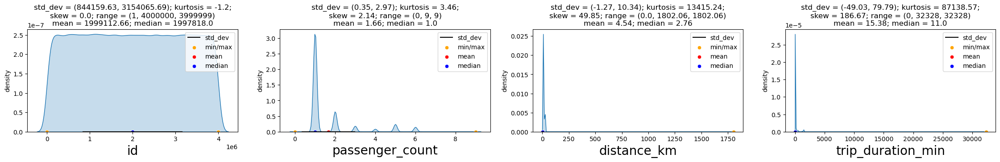

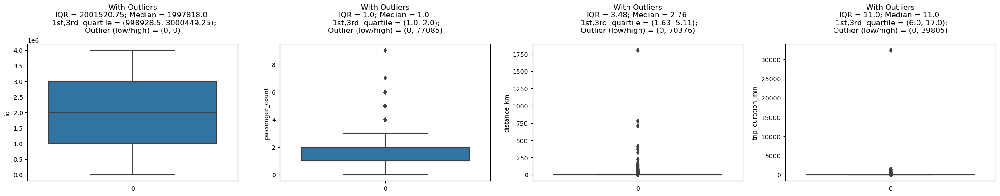

filtering out:  20337


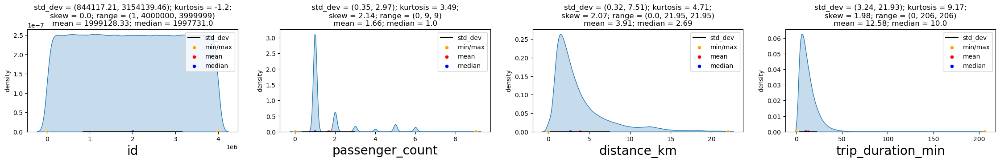

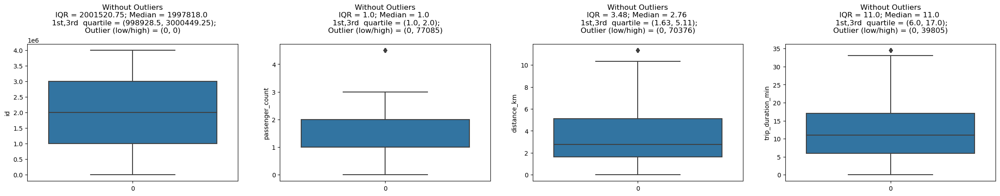

In [ ]:
UVA_numeric(df,trip_details)
UVA_outlier(df,trip_details,)
plt.show()

# trip id :
    # is unique and ranges from 1-4,000,000 with uniform distribution, so we can drop
# passenger_count :
    # ranges from 0-9 with median = 1
    # negligibly biased towards low passenger count with skewness +2.14
    # kurtosis = 3.46 which means having extreme/outlier values
    # there are 33 rows that passenger_count = 0, which need to be inspected. (errorred captured the trip without passenger ?)
    # 4 to 9 passenger are outlier but it can indicate large vehicles like SUV or Van
# distance_km (ranges from 0-1802km) and trip_duration_min (ranges from 0min - 22days)
    # there is extreme outlier of distance and trip duration considering the kurtosis and skewness value


# Removing outlier
factor = 3 # set standard deviation factor
trip_details_filter = df[trip_details].copy()
columns_to_filter = ['distance_km', 'trip_duration_min']

# Filtering using standard deviation (not considering obseravtions > mean + 3* standard deviation)
for col in columns_to_filter:
    threshold = df[col].mean() + factor * df[col].std()
    trip_details_filter = trip_details_filter[trip_details_filter[col] < threshold]
print('filtering out: ',len(df)-len(trip_details_filter)) # checking how many points removed

UVA_numeric(trip_details_filter,trip_details)
UVA_outlier(df,trip_details,include_outlier=False)
# After removing outlier
    # distance_km and trip_duration_min are still skewed to the right with high kurtosis
    # distance_km (from 0-21.95 km) and trip_duration_min (from 0-206 minutes) can be related with the similar distribution

# Thing to investigate
    # Is the lower number in passenger_count also related to the trip's distance and duration ?


### 2.1.2. trip_date

True
True
True
True
True


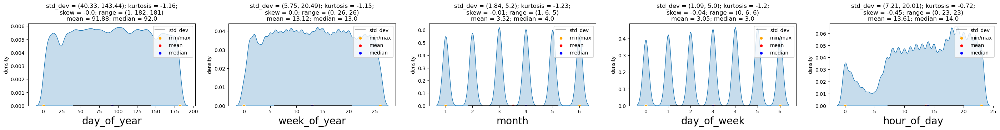

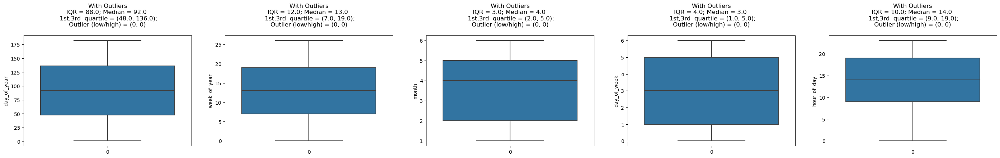

In [ ]:
UVA_numeric(df,trip_date)
UVA_outlier(df,trip_date,)

# day_of_year and week_of_year:
    # both have symmetrical distribution and low extreme value
    # day_of_year range from 1-182, whereas week_of_year from 0-26 (approximate the first six months)

# month and day_of_week and hour_of_day
    # have a nearly symmetrical distribution and low presences of extreme values
    # From the first six months, March has the highest number of trip, followed by April and May.
    # Friday has the highest number of trip, followed by Sat and Thursday.
    # hour_of_day has lower distribution after midnight-7am

# Thing to investigate
    # are there relationship between different time of the day/ day of the week related to the trip durations including weeked or peak hours

## 2.2 Univariate Analysis : Categorical Varibales

In [ ]:
# Custom function for easy visualisation of Categorical Variables
def UVA_category(data, var_group):

  '''
  Univariate_Analysis_categorical
  takes a group of variables (category) and plot/print all the value_counts and barplot.
  '''
  # setting figure_size
  size = len(var_group)
  plt.figure(figsize = (7*size,2.5), dpi = 100)

  # for every variable
  for j,i in enumerate(var_group):
    norm_count = data[i].value_counts(normalize = True)
    n_uni = data[i].nunique()

  #Plotting the variable with every information
    plt.subplot(1,size,j+1)
    sns.barplot(x=norm_count, y=norm_count.index)
    plt.xlabel('fraction/percent', fontsize = 20)
    plt.ylabel('{}'.format(i), fontsize = 20)
    plt.title('n_uniques = {} \n value counts \n {};'.format(n_uni,norm_count))

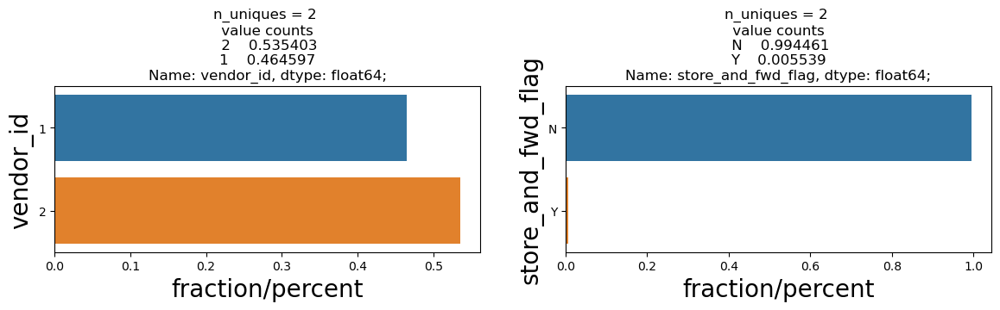

In [ ]:
df.select_dtypes(include=['category']).dtypes
UVA_category(df, ['vendor_id', 'store_and_fwd_flag'])
# Majority of vendor_id is type 2
# there is extremely few number of trip which held in the vehicle's memory before sending it to the vendor
    # it can indicate poor network connection in some areas at the time

# Thing to investigate
    # different of the trip popularity and duration between the different provider. and is it also related to different location or time of the day?

### Summary: Univariate Analysis

1. Trip ID:
    - Consider dropping; it's unique and doesn't offer analytical value.
2. Passenger Count:
    - Investigate 33 instances with passenger_count of 0. Errors or trips without passengers?
    - For counts of 4-9: Indicative of larger vehicles or specific locations?
3. Distance & Trip Duration:
    - Address extreme outliers in distance_km and trip_duration_min. Impact on analysis?
    - Examine the relationship between distance and duration, especially post outlier-removal.
4. Time-Related Variables:
    - Data covers the first six months.Why is March busiest? Why are Fridays more active?
    - Examine trip duration patterns against time of day. Longer durations during peak hours?
5. Vendor ID:
    - Why is vendor_id type 2 predominant? Differences between vendors?
6. Store and Forward Flag:
    - Few trips stored before sending to vendor. Sign of connectivity issues? If so, where and when?
7. General:
    - Investigate time of day/week effects on trip duration. Impact of weekends or peak hours?
    - Compare trip popularity/duration between providers. Does vendor correlate with location or time?

## 3.1 Bivariate Analysis : Numerical-Numerical

C:\Users\Primprim\AppData\Roaming\jupyterlab-desktop\jlab_server\lib\site-packages\scipy\stats\_stats_py.py:5278: RuntimeWarning: overflow encountered in scalar multiply
  (2 * xtie * ytie) / m + x0 * y0 / (9 * m * (size - 2)))


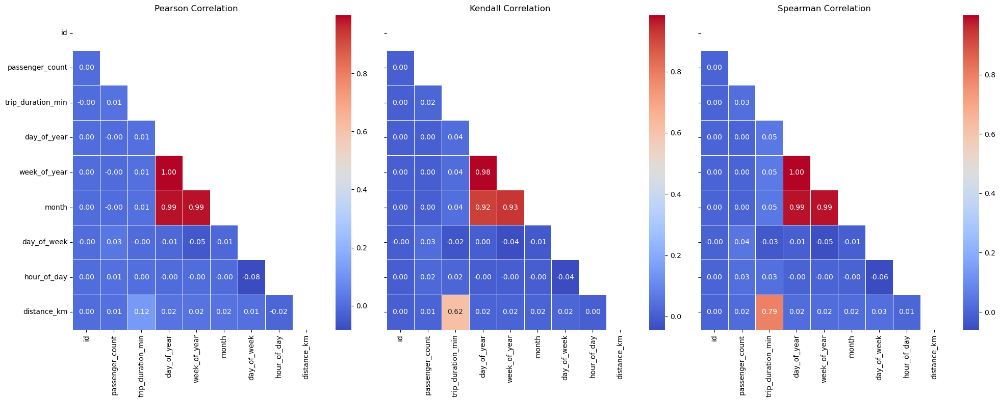

In [ ]:
numerical = df.select_dtypes(include=['int32','int64','float64']).astype('float64')

correlations = ['pearson', 'kendall', 'spearman']
fig, axes = plt.subplots(1, 3, figsize=(20,8), sharey='row')

for i, method in enumerate(correlations):
    corr_matrix = numerical.corr(method=method)
    mask = np.triu(np.ones_like(corr_matrix, dtype=bool))
    sns.heatmap(corr_matrix, mask=mask, ax=axes[i], cmap='coolwarm', linewidths=.5, annot=True, fmt=".2f")
    axes[i].set_title(f'{method.capitalize()} Correlation')
    axes[i].tick_params(axis='x')

plt.tight_layout()
plt.show()

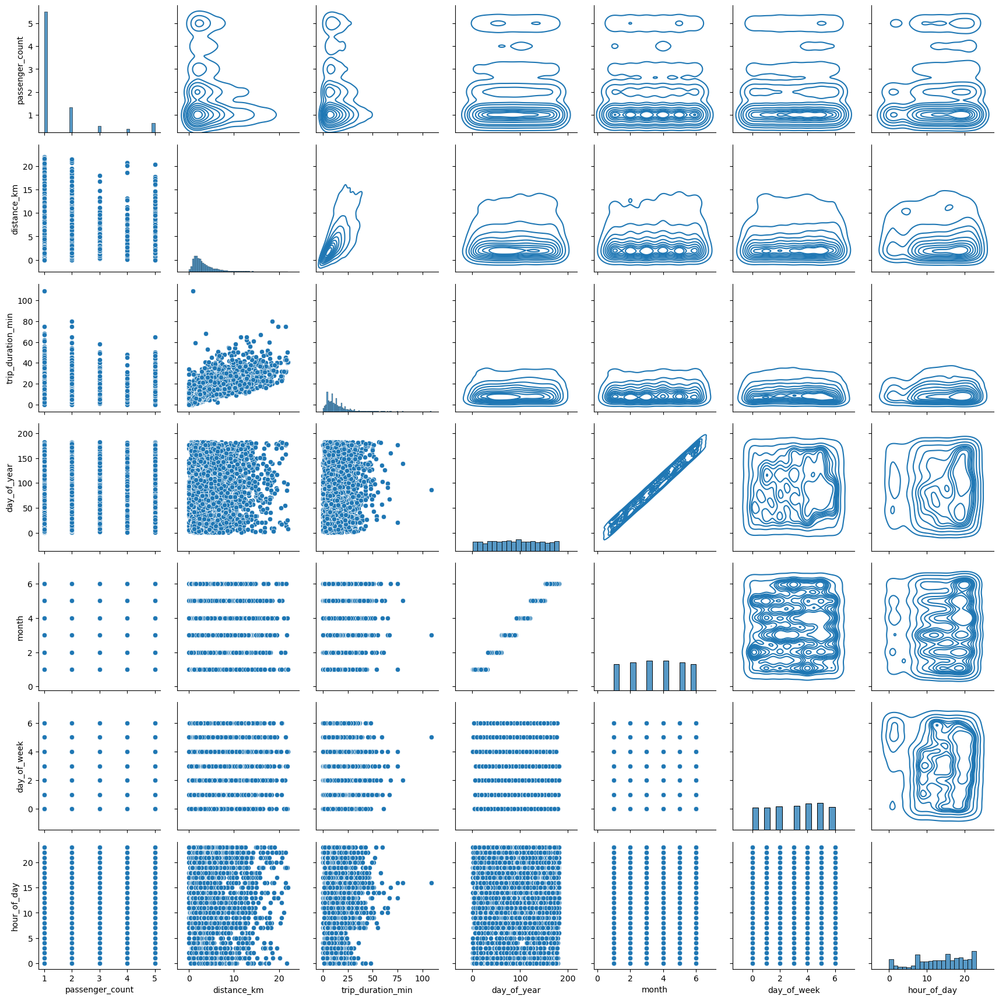

In [ ]:
var = []
var.extend(trip_details)
var.extend(trip_date)
var = [x for x in var if x not in {'id','week_of_year'}] #remove insignificant variables

#remove outlier before pairplot
from scipy.stats import zscore
z_scores = zscore(numerical)
abs_z_scores = np.abs(z_scores)
filtered_entries = (abs_z_scores < 3).all(axis=1)
numerical_filtered = numerical[filtered_entries]

g = sns.PairGrid(numerical_filtered[var].sample(5000))
g.map_upper(sns.kdeplot)
g.map_lower(sns.scatterplot)
g.map_diag(sns.histplot)

# all correlation seem to have a similar pattern except the slight variation in magnitude of correlation.
    # month, day_of_year and week_of_year have the strongest correlation with each other, so we can keep only one column left
    # distance_km and trip_duration_min are high correlated with each other
    # there is no significant relationship among others

### Summary: Bivariate Analysis (Numerical-Numerical)
- Temporal Variables: A strong correlation among 'month', 'day_of_year', and 'week_of_year' so we need to justify a retention of only one to avoid redundancy in future models.

- Travel Variables: 'Distance_km' and 'trip_duration_min' exhibit a notably high correlation, indicating typically longer durations for longer trips, a logical and potentially predictive relationship.

- Other Variables: No significant relationships are found among other variables, suggesting their dependent contributions in predictive scenarios in subsequent analyses.

## 3.2 Bivariate : Categorical-Numerical
Example Investigations:
- Is the trip duration/distance different on weekdays vs. weekends?
- Does the trip duration/distance vary significantly across different hours of the day (peakhr?)
- Is there a noticeable difference in trip duration/distance between different vendors?
- Does the trip duration/distance vary significantly across different months?

In [ ]:
# define weekday - weekend from day_of_week
df['day_type'] = np.where(df['day_of_week'] < 5, 'weekday', 'weekend')
df['day_type'] = df['day_type'].astype('category')

# define peak-hours and off-peak hour from 7-9 AM and 5-7 PM
df['hour_type'] = np.where(((df['hour_of_day'] >= 7) & (df['hour_of_day'] <= 9)) |
                           ((df['hour_of_day'] >= 17) & (df['hour_of_day'] <= 19)),
                           'peak', 'off-peak')
df['hour_type'] = df['hour_type'].astype('category')

In [ ]:
def TwoSampZ(X1, X2, sigma1, sigma2, N1, N2):
  '''
  takes mean, standard deviation, and number of observations and returns p-value calculated for 2-sampled Z-Test
  '''
  from numpy import sqrt, abs, round
  from scipy.stats import norm
  ovr_sigma = sqrt(sigma1**2/N1 + sigma2**2/N2)
  z = (X1 - X2)/ovr_sigma
  pval = 2*(1 - norm.cdf(abs(z)))
  return pval


def TwoSampT(X1, X2, sd1, sd2, n1, n2):
  '''
  takes mean, standard deviation, and number of observations and returns p-value calculated for 2-sample T-Test
  '''
  from numpy import sqrt, abs, round
  from scipy.stats import t as t_dist
  ovr_sd = sqrt(sd1**2/n1 + sd2**2/n2)
  t = (X1 - X2)/ovr_sd
  df = n1+n2-2
  pval = 2*(1 - t_dist.cdf(abs(t),df))
  return pval


def remove_outliers(data, column_name):
    Q1 = data[column_name].quantile(0.25)
    Q3 = data[column_name].quantile(0.75)
    IQR = Q3 - Q1
    data_no_outlier = data[(data[column_name] >= Q1-1.5*IQR) & (data[column_name] <= Q3+1.5*IQR)]
    return data_no_outlier


def Bivariate_cont_cat(data, cont, cat, category, remove_outliers_flag=False):
    # Remove outliers from 'cont' column if flag is True
    if remove_outliers_flag:
        data = remove_outliers(data, cont)

    #creating 2 samples
    x1 = data[cont][data[cat]==category][:]
    x2 = data[cont][~(data[cat]==category)][:]

    #calculating descriptives
    n1, n2 = x1.shape[0], x2.shape[0]
    m1, m2 = x1.mean(), x2.mean()
    std1, std2 = x1.std(), x2.std()

    #calculating p-values
    t_p_val = TwoSampT(m1, m2, std1, std2, n1, n2)
    z_p_val = TwoSampZ(m1, m2, std1, std2, n1, n2)

    #table
    table = pd.pivot_table(data=data, values=cont, columns=cat, aggfunc = np.mean)

    #plotting
    plt.figure(figsize = (10,2), dpi=140)

    #barplot
    plt.subplot(1,2,1)
    sns.barplot(x=[str(category),'not {}'.format(category)], y=[m1, m2])
    plt.ylabel('mean {}'.format(cont))
    plt.xlabel(cat)
    plt.title('t-test p-value = {} \n z-test p-value = {}\n {}'.format(t_p_val, z_p_val, table))

    # boxplot
    plt.subplot(1,2,2)
    sns.boxplot(x=cat, y=cont, data=data)
    plt.title('categorical boxplot')

### 3.2.1 Is the trip duration/distance different on weekdays vs. weekends?

trip_duration_min - day_type:


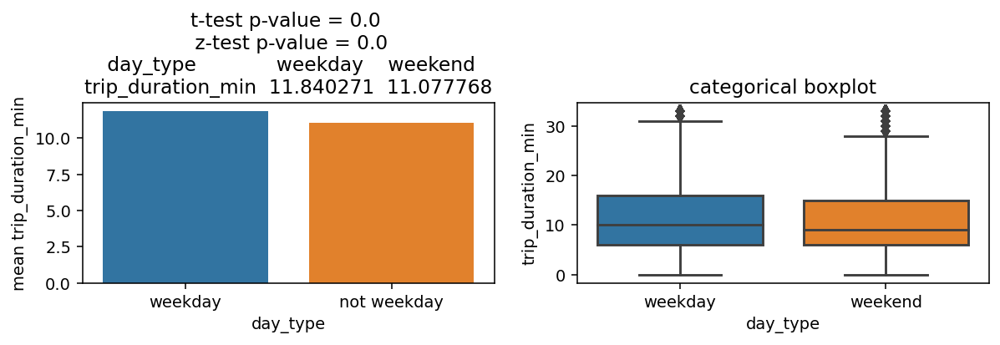

distance_km - day_type:


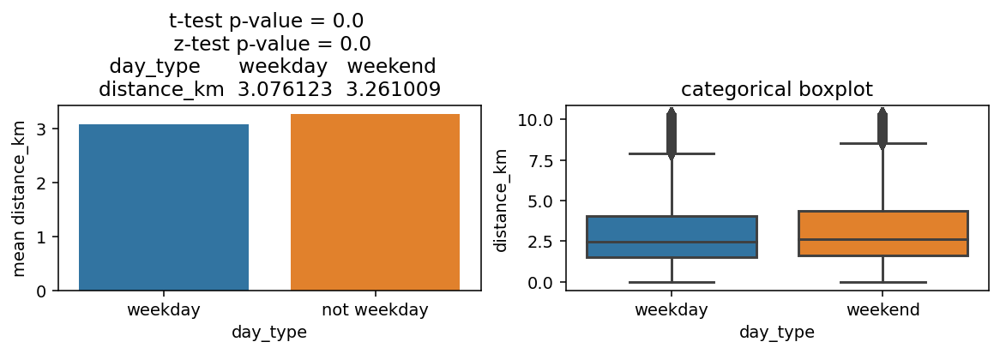

In [ ]:
# Is the trip duration different on weekdays vs. weekends?
    # H0: There is no difference in mean trip duration across weekend and weekday.
    # Ha: There is a different mean trip duration.
    # P-value < 0.05 : H0 is rejected, we we accept the different mean trip duration btw weekend-weekday
    # With and without outlier included, mean trip duration of the weekday > weekend
print('trip_duration_min - day_type:')
Bivariate_cont_cat(df, 'trip_duration_min', 'day_type', 'weekday', remove_outliers_flag=True)
plt.show()


# Is the trip distance different on weekdays vs. weekends?
    # H0: There is no difference in mean trip distance across weekend and weekday.
    # Ha: There is a different mean trip distance.
    # P-value < 0.05 : H0 is rejected, we we accept the different mean trip distance btw weekend-weekday
    # With and without outlier included, mean trip duration btw weekend > weekday
print('distance_km - day_type:')
Bivariate_cont_cat(df, 'distance_km', 'day_type', 'weekday', remove_outliers_flag=True)
plt.show()


### 3.2.2 Does the trip duration/distance vary significantly across different hours of the day (peakhr?)

trip_duration_min - hour_type:


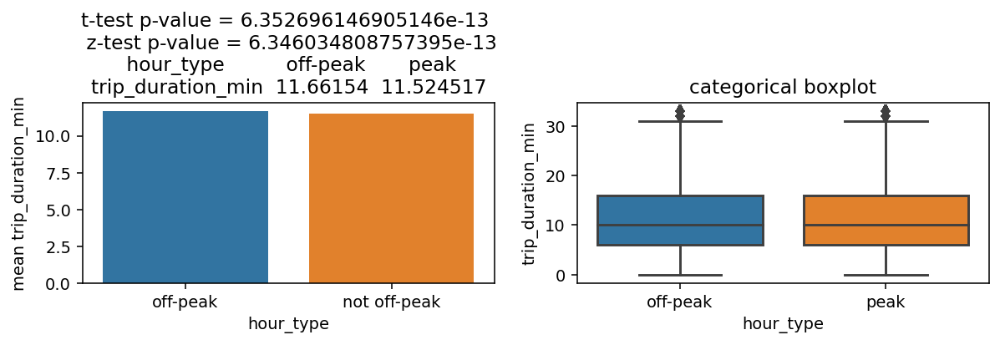

distance_km - hour_type:


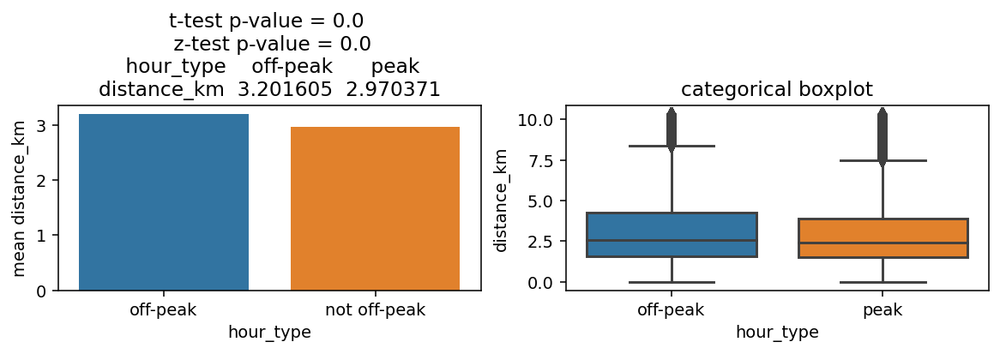

In [ ]:
# Is the trip duration different on peak and off-peak hour of the day?
    # P-value < 0.05 : H0 is rejected, we we accept the different mean trip duration btw peak and off-peak hour
    # With and without outlier included, mean trip duration of off-peak hour > peak hour
print('trip_duration_min - hour_type:')
Bivariate_cont_cat(df, 'trip_duration_min', 'hour_type', 'off-peak', remove_outliers_flag=True)
plt.show()

# Is the trip distance different on peak and off-peak hour of the day?
    # P-value < 0.05 : H0 is rejected, we we accept the different mean trip distance btw peak and off-peak hour
    # With and without outlier included, mean trip distance of off-peak hour > peak hour
print('distance_km - hour_type:')
Bivariate_cont_cat(df, 'distance_km', 'hour_type', 'off-peak', remove_outliers_flag=True)
plt.show()

### 3.2.3 Is there a noticeable difference in trip duration/distance between different vendors?

trip_duration_min - vendor_id:


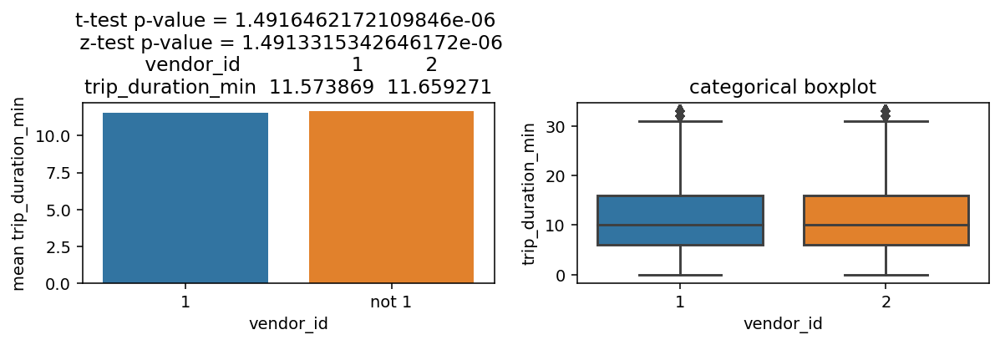

distance_km - vendor_id:


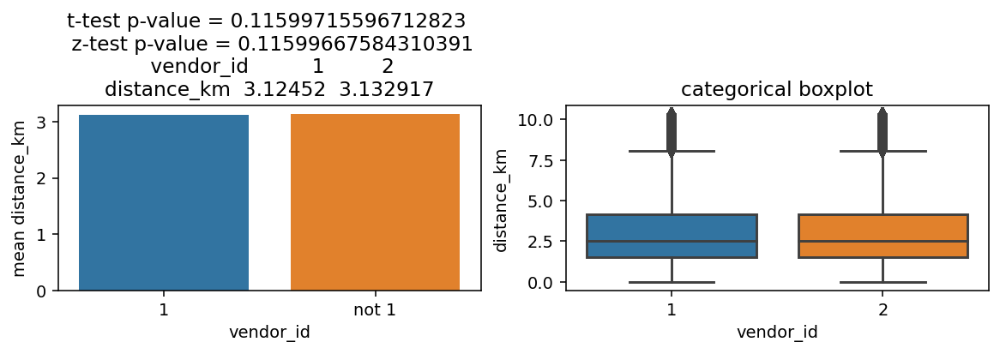

In [ ]:
# Is there a noticeable difference in mean trip duration/distance between different vendors?
    # There is a significant difference in trip duration and distance btw vendors (vendor 2 has a higher mean trip duration/distance)
    # However, without outlier, there is no significant difference in trip distance
print('trip_duration_min - vendor_id:')
Bivariate_cont_cat(df, 'trip_duration_min', 'vendor_id', 1, remove_outliers_flag=True)
plt.show()
print('distance_km - vendor_id:')
Bivariate_cont_cat(df, 'distance_km', 'vendor_id', 1, remove_outliers_flag=True)
plt.show()

### 3.2.4 Is there a noticeable difference in trip duration/distance between different store_and_fwd_flag?

trip_duration_min - store_and_fwd_flag:


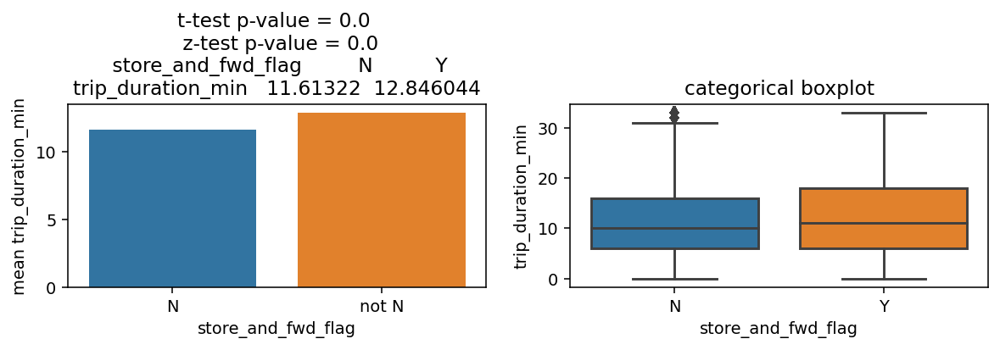

distance_km - store_and_fwd_flag:


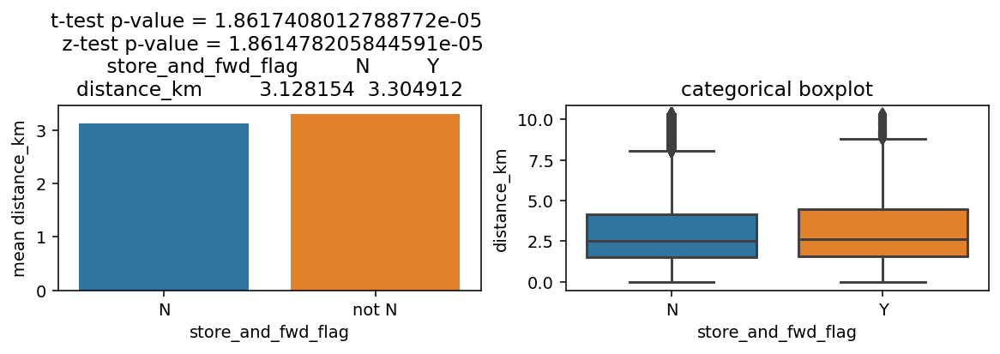

In [ ]:
# Is there a noticeable difference in mean trip duration/distance between different store_and_fwd_flag?
    # There is a significant difference in trip duration and distance
    # The trips which be stored before sending to vendor, has a higher mean trip duration/distance)
print('trip_duration_min - store_and_fwd_flag:')
Bivariate_cont_cat(df, 'trip_duration_min', 'store_and_fwd_flag', 'N', remove_outliers_flag=True)
plt.show()

print('distance_km - store_and_fwd_flag:')
Bivariate_cont_cat(df, 'distance_km', 'store_and_fwd_flag', 'N', remove_outliers_flag=True)
plt.show()


### 3.2.5 Does the trip duration/distance vary significantly across different months?

C:\Users\Primprim\AppData\Roaming\jupyterlab-desktop\jlab_server\lib\site-packages\scipy\stats\_morestats.py:1816: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


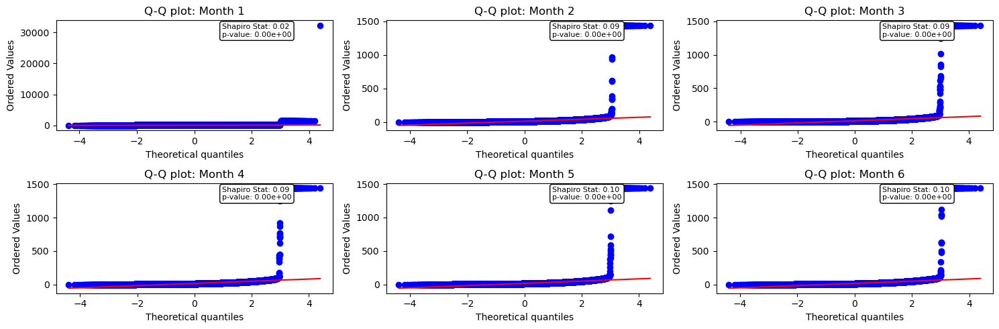

In [ ]:
# Before apply ANOVA (Analysis of Variance)
# We use Q-Q plot and Shapiro-Wilk Test to check trip_duration_min data normality of the distribution across the months
import scipy.stats as stats
from scipy.stats import shapiro

months = sorted(df['month'].unique())
num_cols = 3
fig, axes = plt.subplots(2, num_cols, figsize=(15, 5))

for i, month in enumerate(months):
    row = i // num_cols
    col = i % num_cols

    # Subset data for the specific month
    month_data = df['trip_duration_min'][df['month'] == month]

    # Q-Q plot
    stats.probplot(month_data, plot=axes[row, col])

    # Perform Shapiro-Wilk test
    shap_stat, shap_p = stats.shapiro(month_data)

    # title and Shapiro-Wilk test results to subplot
    axes[row, col].set_title(f'Q-Q plot: Month {month}')
    axes[row, col].annotate(f'Shapiro Stat: {shap_stat:.2f}\np-value: {shap_p:.2e}',
                            xy=(0.6, 0.85), xycoords='axes fraction',
                            bbox=dict(boxstyle="round,pad=0.3", edgecolor="black", facecolor="white"),
                            fontsize=8)
plt.tight_layout()
plt.show()
# As shap p-value < threshold 0.05, it indicates that the variable is not normally distributed
# So we will use Kruskal-Wallis H-test ( non-parametric version of ANOVA) instead

In [ ]:
def one_way_ANOVA(data, cont, cat, remove_outliers_flag=False):
    '''
    find differences between  groups of an independent variable on a continuous
    '''
    # Remove outliers from 'cont' column if flag is True
    if remove_outliers_flag:
        data = remove_outliers(data, cont)

    # Creating n samples based on categories
    samples = []
    for cat_value in data[cat].unique():
        sample = data[cont][data[cat] == cat_value].values
        samples.append(sample)

    # Performing Kruskal-Wallis H-test
    h_stat, p_val = stats.kruskal(*samples)

    # Table
    table = pd.pivot_table(data=data, values=cont, columns=cat, aggfunc=np.mean).applymap("{:.2f}".format)

    # Plotting
    plt.figure(figsize = (12, 2), dpi=140)

    # Barplot
    plt.subplot(1, 2, 1)
    sns.barplot(x=cat, y=cont, data=data)
    plt.ylabel(f'Mean {cont}')
    plt.xlabel(cat)
    plt.title(f'Kruskal-Wallis H-test p-value = {p_val:.2e} \n{table}')

    # Boxplot
    plt.subplot(1, 2, 2)
    sns.boxplot(x=cat, y=cont, data=data)
    plt.title('Categorical boxplot')

trip_duration_min - month:


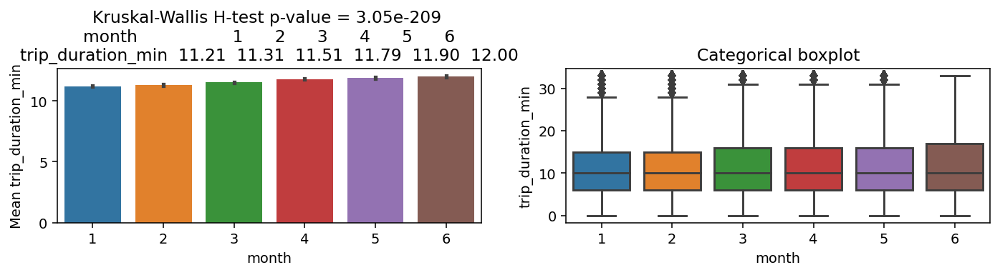

distance_km - month:


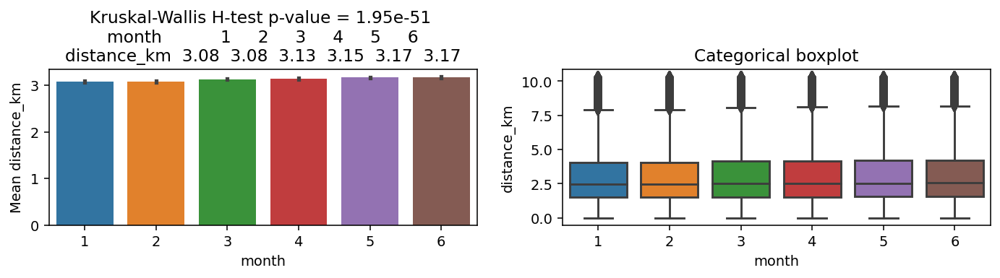

In [ ]:
print('trip_duration_min - month:')
one_way_ANOVA(df, 'trip_duration_min', 'month', remove_outliers_flag=True)
plt.show()
# Kruskal-Wallis H-test P-value indicate a significant difference of mean trip duration and distance at least one months

print('distance_km - month:')
one_way_ANOVA(df, 'distance_km', 'month', remove_outliers_flag=True)
plt.show()

### Summary: Bivariate Analysis (Categorical-Numerical)
1. Weekday vs. Weekend Travel Patterns:
- Mean trip durations were longer on weekdays, while mean distances were longer on weekends.
- This might imply perhaps more frequent commutes on weekdays (potentially due to work-related activities) and leisurely, longer-distance travels on weekends. Traffic congestion and user travel intent during weekdays vs. weekends warrant further exploration.

2. Hourly Variations in Travel:
- Mean trip duration and distance were greater during off-peak hours than during peak hours.
- People might prefer traveling more during off-peak hours to avoid congestion, or the nature of trips might be different during these times.

3. Vendor-Related Findings:
- Vendor 2 taxis tend to have longer trip duration but the same distance. This might be operational or service differences between the vendors that influence these travel patterns.
- The stored trips before vendor dispatch also demonstrate longer durations/distances. The peculiar pattern in stored trips necessitates an in-depth look into vendor dispatch mechanisms and potential delays.

4. Monthly Travel Patterns:
- Some months exhibit higher mean durations and distances for trips. These variances might be attributed to numerous factors like holidays, seasonal activities, or weather conditions influencing travel behavior in certain months.

## 3.3 Bivariate : Categorical-Categorical
Example Investigations:

- Is a choice of taxi vendor independent of temporal variable ?
    - the day between a weekday or a weekend ?
    - a peak-hour or a off-peak ?
    - different month ?
- Are there any association between group of passenger and trip's distance type ?
    - Is none passenger related to an error / really short distance travel ?
    - do different groups of passengers differ on different vendors ?
- Is a choice of store_and_fwd_flag independent of whether:
    - number of passenger ?
    - different vender ?
    - distance_type ?

In [ ]:
def BVA_categorical_plot(data, tar, cat):
    '''
    take data and two categorical variables,
    calculates the chi2 significance between the two variables
    and prints the result with countplot & CrossTab
    '''
    #isolating the variables
    data = data[[cat,tar]][:]

    #forming a crosstab
    table = pd.crosstab(data[tar],data[cat])

    #performing chi2 test
    from scipy.stats import chi2_contingency
    chi, p, dof, expected = chi2_contingency(table)

    #checking whether results are significant
    if p<0.05:
        sig = True
    else:
        sig = False

    #setting up the matplotlib figure
    fig, axes = plt.subplots(1, 2, figsize=(10, 3.5))
    desired_order = sorted(data[tar].unique(), reverse=False)

    #plotting grouped plot
    sns.countplot(x=cat, hue=tar, data=data, ax=axes[0], hue_order=desired_order)
    axes[0].set_title(f"p-value = {round(p, 8)}\n difference significant? = {sig}\n")

    #plotting percent stacked bar plot
    ax1 = pd.crosstab(data[cat], data[tar], normalize='index')[desired_order]
    ax1.plot(kind='bar', stacked=True, ax=axes[1], title=str(ax1))

    plt.tight_layout()
    plt.show()

### 3.3.1  Is a choice of taxi vendor independent of temporal variables:
- the day between a weekday or a weekend ?
- a peak-hour or a off-peak ?
- different month ?

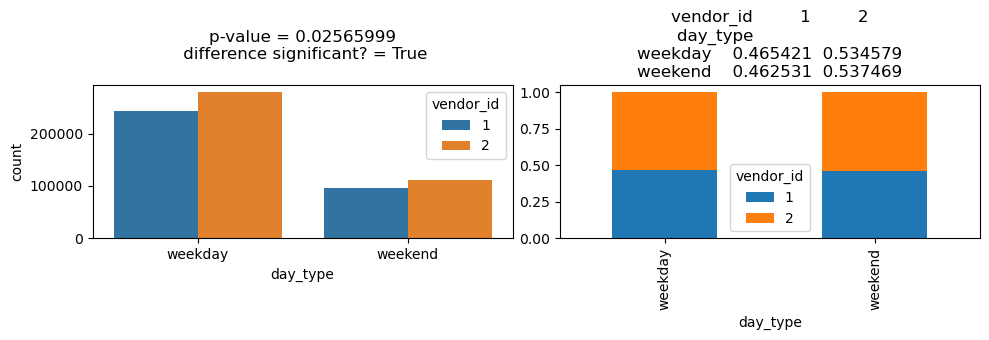

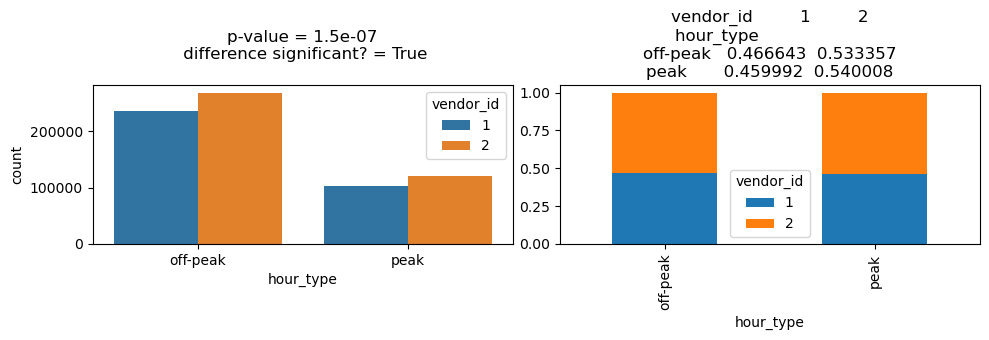

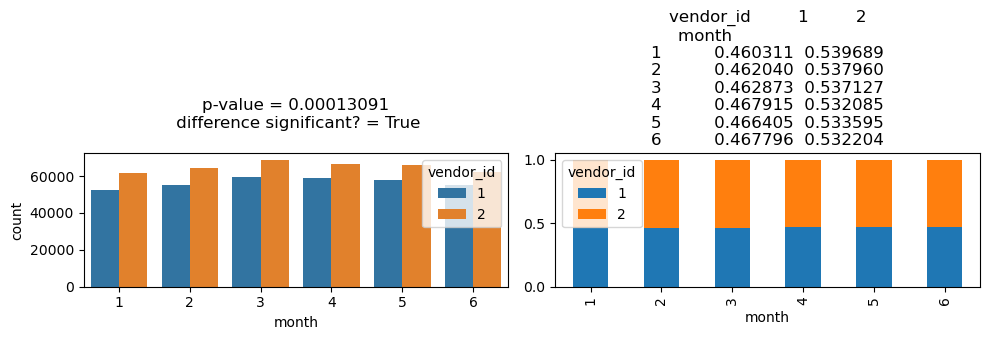

In [ ]:
BVA_categorical_plot(df, 'vendor_id', 'day_type')
BVA_categorical_plot(df, 'vendor_id', 'hour_type')
BVA_categorical_plot(df, 'vendor_id', 'month')
# There is a less practical significance visualized on the stacked bar plot
# But there is a statistical significance in a difference btw 'vendor_id' and 'day_type'/ 'hour_type'/'month' from p-value,

### 3.3.2 Are there any association between group of passenger and distance type ?
- Is none passenger related to an error / really short distance travel ?
- do different groups of passengers differ on different vendors ?

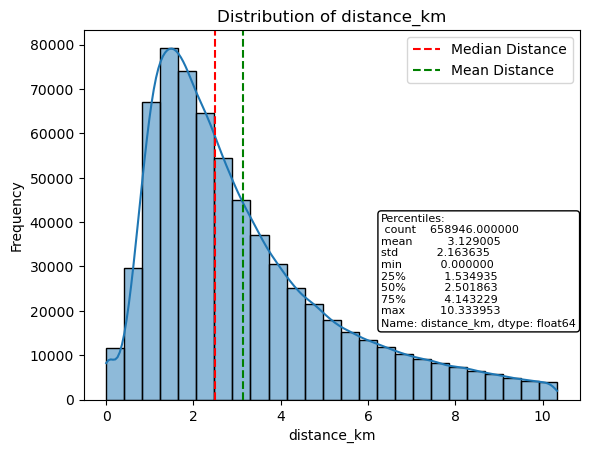

In [ ]:
# assign trips that fall below the 50th percentile (median) of all trip as "short," and those above might be considered "long
def plot_distribution(df, col, hue=None, remove_outliers_flag=False, annotation=False, bins='auto'):
    """
    Create a histogram for distance distribution, highlighting the median and mean.
    """
    # Remove outliers
    if remove_outliers_flag:
        filtered_df = remove_outliers(df, col)
        # Get distance percentiles
        Percentiles = filtered_df[col].describe(percentiles=[.25, .5, .75])
    else:
        filtered_df = df
        Percentiles = df[col].describe(percentiles=[.25, .5, .75])

    # Plot histogram
    #sns.histplot(data=filtered_df, x=col, bins=30, kde=True)
    sns.histplot(data=filtered_df, x=col, bins=bins, kde=True, hue=hue) #, fill=False

    # Add median line
    plt.axvline(filtered_df[col].median(), color='r', linestyle='--', label='Median Distance')
    # Add mean line
    plt.axvline(filtered_df[col].mean(), color='g', linestyle='--', label='Mean Distance')

        # Add titles and labels
    plt.title(f'Distribution of {col}')
    plt.xlabel(col)
    plt.ylabel('Frequency')

    # Annotate percentiles
    if annotation:
        plt.annotate(f'Percentiles:\n {Percentiles}',
                     xy=(0.6, 0.2), xycoords='axes fraction',
                     bbox=dict(boxstyle="round,pad=0.3", edgecolor="black", facecolor="white"),
                     fontsize=8)
    plt.legend()
    plt.show()

plot_distribution(df, 'distance_km', remove_outliers_flag=True, annotation=True, bins=25)

In [ ]:
# create distance_type bin as none, short and long distance
filtered_df = remove_outliers(df, 'distance_km')
distance_km_median = filtered_df['distance_km'].median()
df['distance_type'] = ['0_distance' if x < 0.1 else 'short' if x <= distance_km_median else 'long' for x in df['distance_km']]

# create passenger_bin none: 0, single: 1, small: 2-4, large: 5-9
bin_edges = [-1, 0, 1, 4, max(df['passenger_count'])]
bin_labels = ['0_passenger', 'single', 'small', 'large']
df['passenger_bin'] = pd.cut(df['passenger_count'], bins=bin_edges, labels=bin_labels, right=True, include_lowest=True)

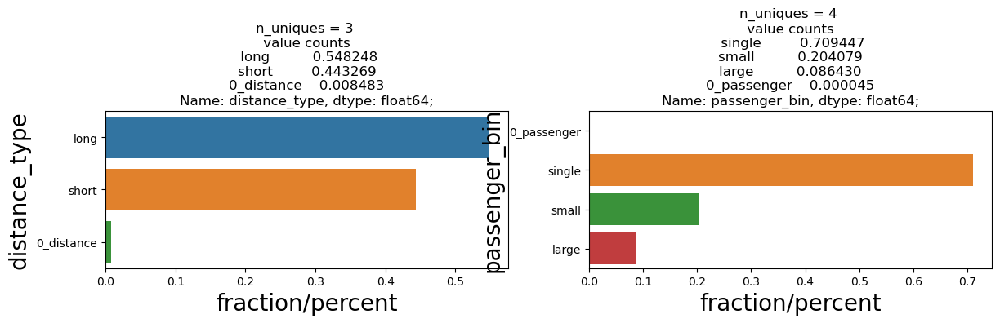

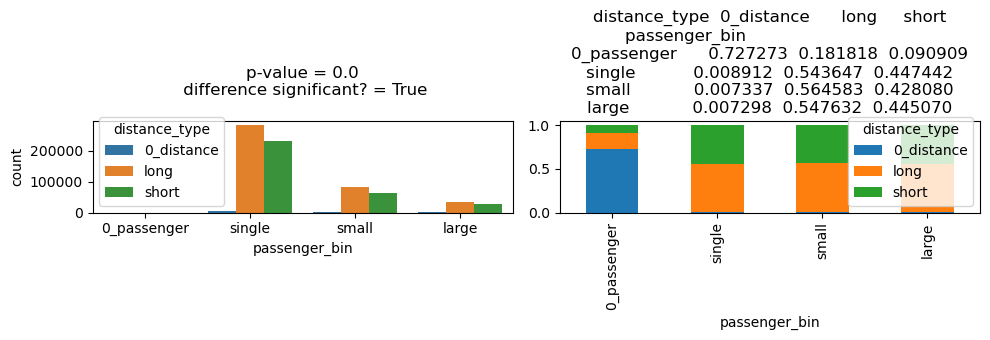

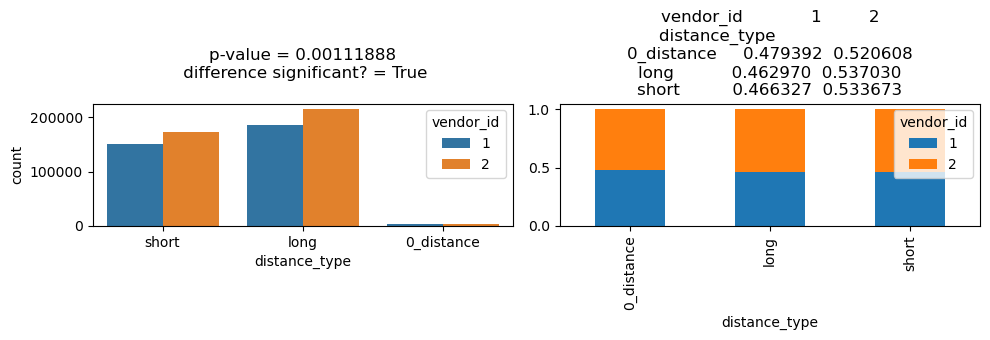

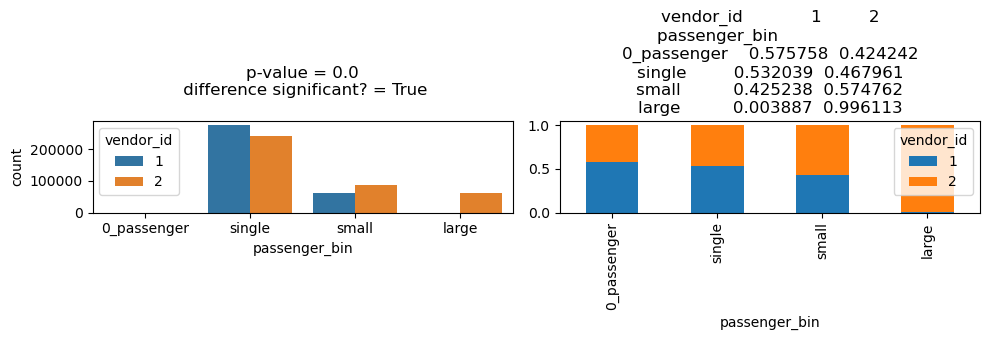

In [ ]:
UVA_category(df, ['distance_type', 'passenger_bin'])
BVA_categorical_plot(df, 'distance_type', 'passenger_bin')
# the taxi with 0 passenger has majority of travelling distance less than 0.1 km, which be found on both vendors
# there is statistical significance in difference between group of passenger and trip's distance type

BVA_categorical_plot(df, 'vendor_id', 'distance_type')
BVA_categorical_plot(df, 'vendor_id', 'passenger_bin')
# there is no large group of passengers on vendor 1

### 3.3.3  Is a choice of store_and_fwd_flag independent of whether:
- Number of passenger ?
- Different vender ?
- Distance_type ?

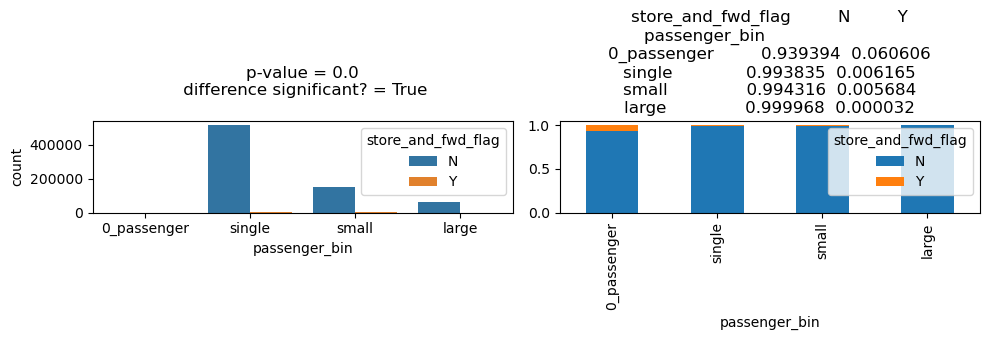

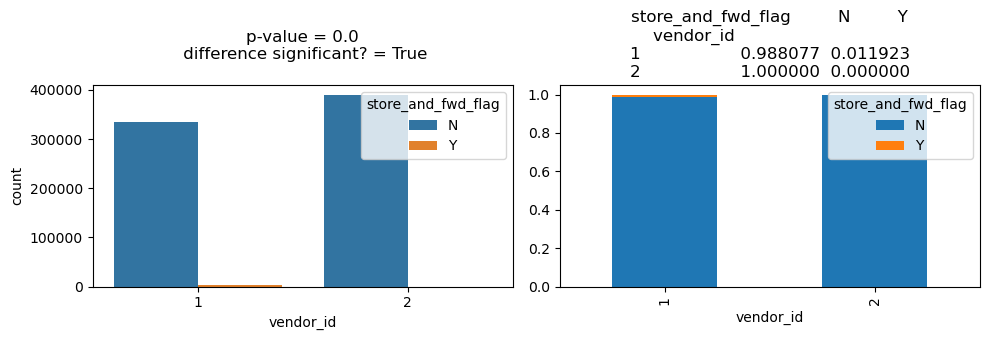

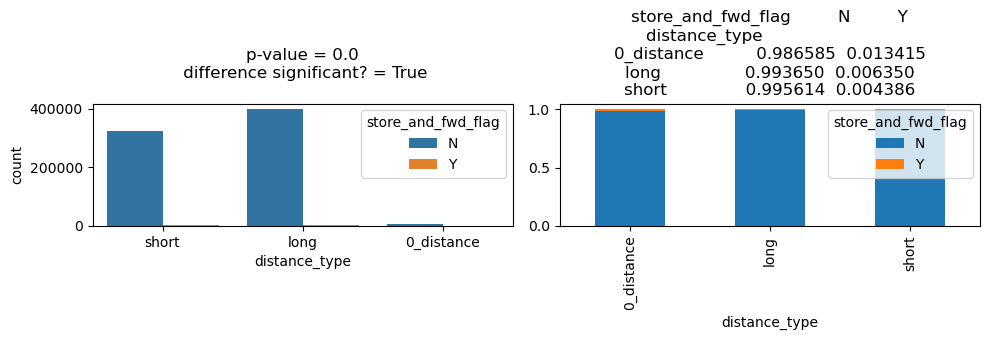

In [ ]:
BVA_categorical_plot(df, 'store_and_fwd_flag', 'passenger_bin')
BVA_categorical_plot(df, 'store_and_fwd_flag', 'vendor_id')
BVA_categorical_plot(df, 'store_and_fwd_flag', 'distance_type')

# we found that stored trips before vendor dispatch related to the trip with no passenger
# it also only appear on vendor 1 with majority of 0 distance trip

### Summary: Bivariate Analysis (Categorical-Categorical) Findings
1. Vendor Choice vs. Time Variables:
    - Statistical significance is found between 'vendor_id' and 'day_type', 'hour_type', and 'month', despite limited practical significance seen in stacked bar plots.
    
2. Passenger Group vs. Trip Distance:
    - The taxis with 0 passengers, predominantly found in trips less than 0.1 km, indicates a potential issue with data recording or short operational runs. Statistical significance exists between passenger groups and trip distance types
    - There is a notable absence of larger passenger groups in vendor 1
    
3. Choice of store_and_fwd_flag:
    - The storing of trips before dispatching correlates with 0-passenger trips and is specifically observed in vendor 1 with the majority of 0-distance trips.
    - This suggests potential technical or operational peculiarities requiring further investigation.

## 4.0 Multivariate Analysis
    4.1 Analyzing Temporal Patterns with distance and duration
    4.2 Vendor-Specific and Flag Exploration  
    4.3 Passenger Correlation
    4.4 Spatial Analysis

In [ ]:
def plot_heatmaps(data, value1, value2, index, columns, separate_by=None, remove_outliers_flag=False):
    """
    Create two heatmaps side by side based on pivot tables,
    separated by unique values in another column if specified.
    """
    if remove_outliers_flag:
        data = remove_outliers(data, value1)
        data = remove_outliers(data, value2)

    # Check if a separating column is specified
    if separate_by:
        unique_vals = data[separate_by].unique()
    else:
        unique_vals = [None]

    for val in unique_vals:
        if val is not None:
            data_subset = data[data[separate_by] == val]
            fig_title_suffix = f' for {separate_by} = {val}'
        else:
            data_subset = data
            fig_title_suffix = ''

        # Create pivot tables
        pivot1 = pd.pivot_table(data_subset, values=value1, index=index, columns=columns, aggfunc='mean')
        pivot2 = pd.pivot_table(data_subset, values=value2, index=index, columns=columns, aggfunc='mean')

        # Set up the matplotlib figure and axes
        fig, ax = plt.subplots(1, 2, figsize=(14, 5))

        # Plot Heatmap for value1
        sns.heatmap(pivot1, ax=ax[0], cmap='YlGnBu', annot=True, fmt=".2f", linewidths=.5)
        ax[0].set_title(f'Average {value1}\n per {index} and {columns}{fig_title_suffix}\n')
        ax[0].set_xlabel(columns)
        ax[0].set_ylabel(index)
        ax[0].invert_yaxis()

        # Plot Heatmap for value2
        sns.heatmap(pivot2, ax=ax[1], cmap='YlGnBu', annot=True, fmt=".2f", linewidths=.5)
        ax[1].set_title(f'Average {value2}\n per {index} and {columns}{fig_title_suffix}\n')
        ax[1].set_xlabel(columns)
        ax[1].set_ylabel(index)
        ax[1].invert_yaxis()

        plt.tight_layout()
        plt.show()

In [ ]:
def horizontal_plot_box(data, x, y1, y2, hue, remove_outliers_flag=False):
    """
    Create side-by-side horizontal violin plots for two dependent variables against one independent variable.
    """
    # Remove outliers from 'cont' column if flag is True
    if remove_outliers_flag:
        data = remove_outliers(data, y1)
        data = remove_outliers(data, y2)

    fig, ax = plt.subplots(1, 2, figsize=(14, 10))
    flierprops = dict(marker='x', markersize=2, markerfacecolor='grey', alpha=0.1)

    # Plot Violin plot for y1
    sns.boxplot(y=x, x=y1, data=data, ax=ax[0], orient='h', hue=hue, width=.5, flierprops=flierprops)
    ax[0].set_title(f'{y1} per {x}')
    ax[0].set_xlabel(y1)
    ax[0].set_ylabel(x)
    ax[0].invert_yaxis()
    ax[0].get_legend().remove()

    # Plot Violin plot for y2
    sns.boxplot(y=x, x=y2, data=data, ax=ax[1], orient='h', hue=hue, width=.5, flierprops=flierprops)
    ax[1].set_title(f'{y2} per {x}')
    ax[1].set_xlabel(y2)
    ax[1].set_ylabel(x)
    ax[1].invert_yaxis()

    plt.legend(title=hue, bbox_to_anchor=(1, 0.5), loc='center left')
    plt.tight_layout()

    plt.show()

def vertical_plot_box(data, x, y1, y2, hue, remove_outliers_flag=False):
    """
    Create side-by-side vertical violin plots for two dependent variables against one independent variable.
    """
    # Remove outliers from 'cont' column if flag is True
    if remove_outliers_flag:
        data = remove_outliers(data, y1)
        data = remove_outliers(data, y2)

    fig, ax = plt.subplots(1, 2, figsize=(14, 4.5))
    flierprops = dict(marker='x', markersize=2, markerfacecolor='grey', alpha=0.1)

    # Plot Boxplot for y1
    sns.boxplot(x=x, y=y1, data=data, ax=ax[0], orient='v', hue=hue, width=.5, flierprops=flierprops)
    ax[0].set_title(f'{y1} per {x}')
    ax[0].set_xlabel(x)
    ax[0].set_ylabel(y1)
    ax[0].get_legend().remove()  # Remove legend for the first subplot to avoid duplication

    # Plot Boxplot for y2
    sns.boxplot(x=x, y=y2, data=data, ax=ax[1], orient='v', hue=hue, width=.5, flierprops=flierprops)
    ax[1].set_title(f'{y2} per {x}')
    ax[1].set_xlabel(x)
    ax[1].set_ylabel(y2)

    plt.legend(title=hue, bbox_to_anchor=(1, 0.5), loc='center left')
    plt.tight_layout()
    plt.show()

### 4.1 Analyzing Temporal Patterns with distance and duration


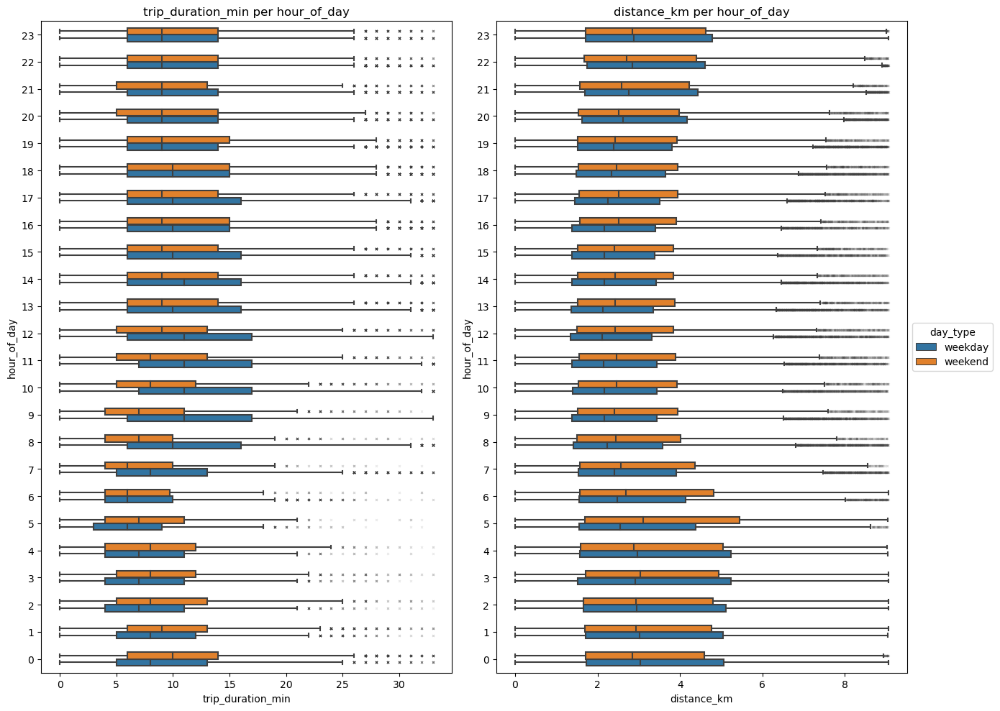

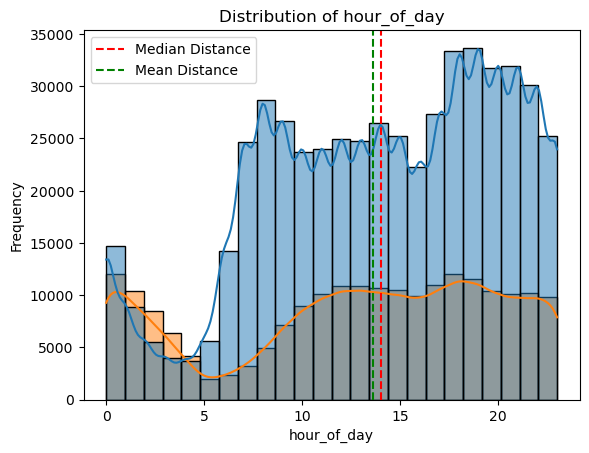

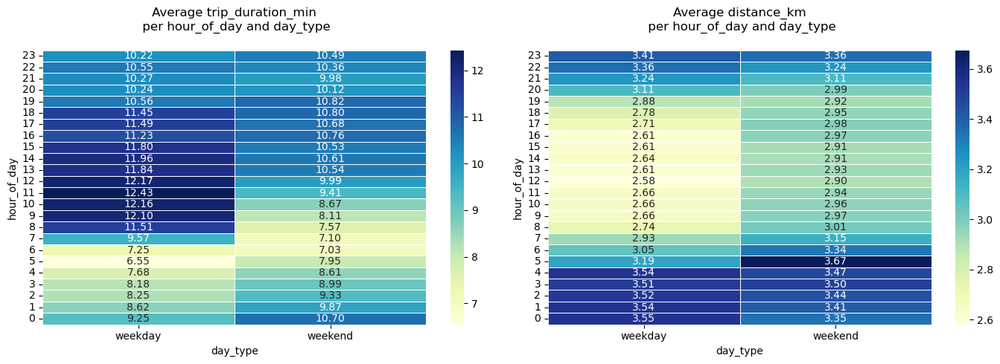

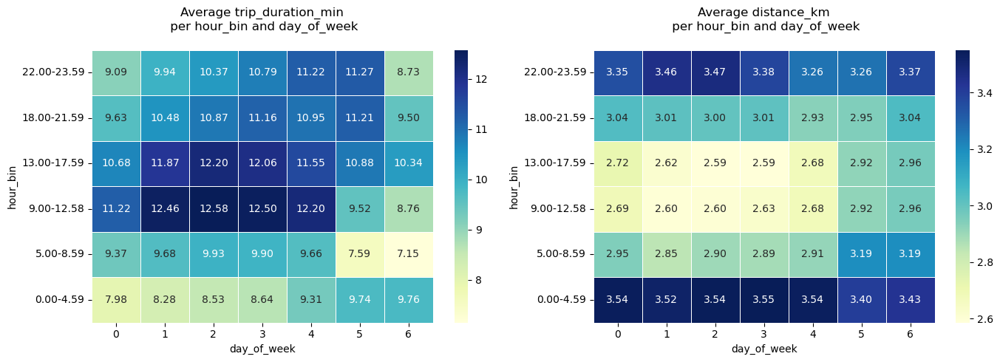

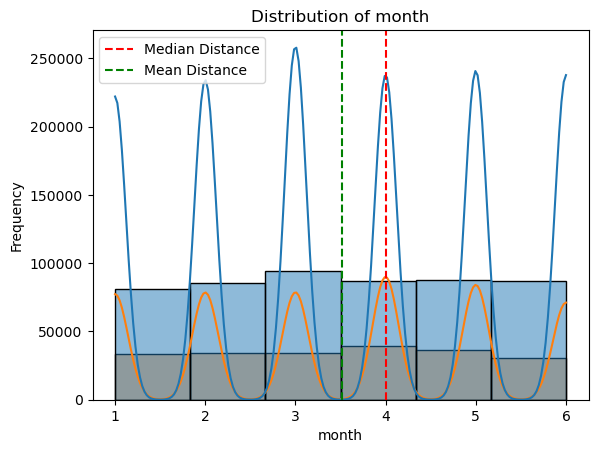

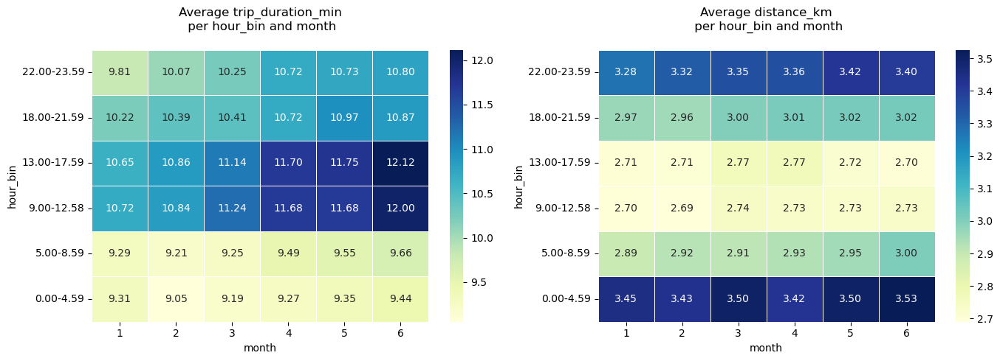

In [ ]:
# Compare Boxplot of trip_duration_min on each hour_of_day distributed by weekend - weekday
horizontal_plot_box(df, 'hour_of_day', 'trip_duration_min', 'distance_km', 'day_type', remove_outliers_flag=True)
plot_distribution(df, 'hour_of_day', hue='day_type', bins=24)

# Compare heatmap of trip_duration_min and trip_distance distributed by weekend - weekday
plot_heatmaps(df, 'trip_duration_min', 'distance_km', 'hour_of_day', 'day_type', remove_outliers_flag=True)

# Compare heatmap of trip_duration_min and trip_distance distributed by hour bins
bins = [-1, 4, 8, 12, 17, 21, 23]
labels = ['0.00-4.59', '5.00-8.59', '9.00-12.58', '13.00-17.59', '18.00-21.59', '22.00-23.59']
df['hour_bin'] = pd.cut(df['hour_of_day'], bins=bins, labels=labels, include_lowest=True, right=True)
plot_heatmaps(df, 'trip_duration_min', 'distance_km', 'hour_bin', 'day_of_week', remove_outliers_flag=True)

# Compare heatmap of trip_duration_min and trip_distance distributed by month
plot_distribution(df, 'month', hue='day_type', bins=6)
plot_heatmaps(df, 'trip_duration_min', 'distance_km', 'hour_bin', 'month', remove_outliers_flag=True)



#### Summary:
1. Higher Distance Travelling After Midnight and Peak in Early Morning on Weekdays
    - This might indicate the movement of individuals who work late-night or early-morning shifts
    - It's also possible that long-distance travel in the early hours is due to less traffic congestion, making it convenient for individuals to travel farther distances in shorter durations.
    
2. Less Distance Travel from 8 AM to Midday on Weekdays
    - may be due to people typically having arrived at their workplaces/schools (assuming a conventional 9 AM to 5 PM schedule)
    - Short trips during this time might be associated with tasks like midday errands or short-distance business-related travels.
    
3. Higher Trip Duration from 8 AM and Peaking at 2 PM - 6 PM on Weekdays
    - Longer durations on short distance may be reflective of potential traffic congestion during the pre-work, post-lunch and after-work hours.
    
4. On Weekends, Less Trip Duration from 5 AM - 10 PM Before a Gradual Increase Through the Day
    - The shorter durations in the morning hours on weekends might be indicative of less traffic (as people tend to sleep in) and, consequently, faster travel times. The gradual increase and sustainment of longer durations through the day might be associated with recreational.
    
5. The surge in longer-distance travel during the early morning hours on weekends  
    - particularly between 4-7am, may be attributed to various factors, such as late-night or early morning social activities, weekend getaways, or individuals commuting to or from shift work.
    - This travel pattern might be particularly pronounced due to lower traffic volumes, enabling quicker travel across larger distances.
    
6. There is no significant difference in each month's pattern


In [ ]:
def plot_pairgrid(data, columns, hue, style_col=None, sample_size=5000, outlier_cols=None):
    """
    Plots a seaborn PairGrid for selected columns of the dataset.
    """
    # Handle outlier removal if specified
    if outlier_cols:
        for col in outlier_cols:
            data = remove_outliers(data, col)

    # Scaling the selected columns
    #scaler = MinMaxScaler()
    #data[columns] = scaler.fit_transform(data[columns])

    # Sampling the data to make the plot more manageable and performant
    sampled_data = data.sample(n=min(sample_size, len(data)))

    # Creating the PairGrid
    g = sns.PairGrid(sampled_data[columns], hue=hue, corner=True)
    # Mapping plots to the lower, upper, and diagonal subplots
    g.map_lower(sns.kdeplot, hue=None, levels=5, color=".2")
    g.map_diag(sns.histplot, element="step", linewidth=0, kde=True)

    if style_col:
        g.map_lower(sns.scatterplot, marker='o', size=data[style_col],sizes=(50, 10))
    else:
        g.map_lower(sns.scatterplot, marker='o' ,sizes=5)

    # Adding a legend
    g.add_legend(loc='center right')

    # Showing the plot
    plt.show()

### 4.2 Vendor-Specific and Flag Exploration  

#### Summary:
- Vendor 1 predominantly demonstrates a pattern of storing trips before dispatching, notably correlating with trips that carry 0 passengers.
- Vendor 2 appears to predominantly serve larger passenger groups.
- Trips with 1 passenger are mainly handled by Vendor 1.
- Records of trips without passengers and those with 7-9 passengers are identified as outliers in the dataset.
- No other relationships of significance were identified.

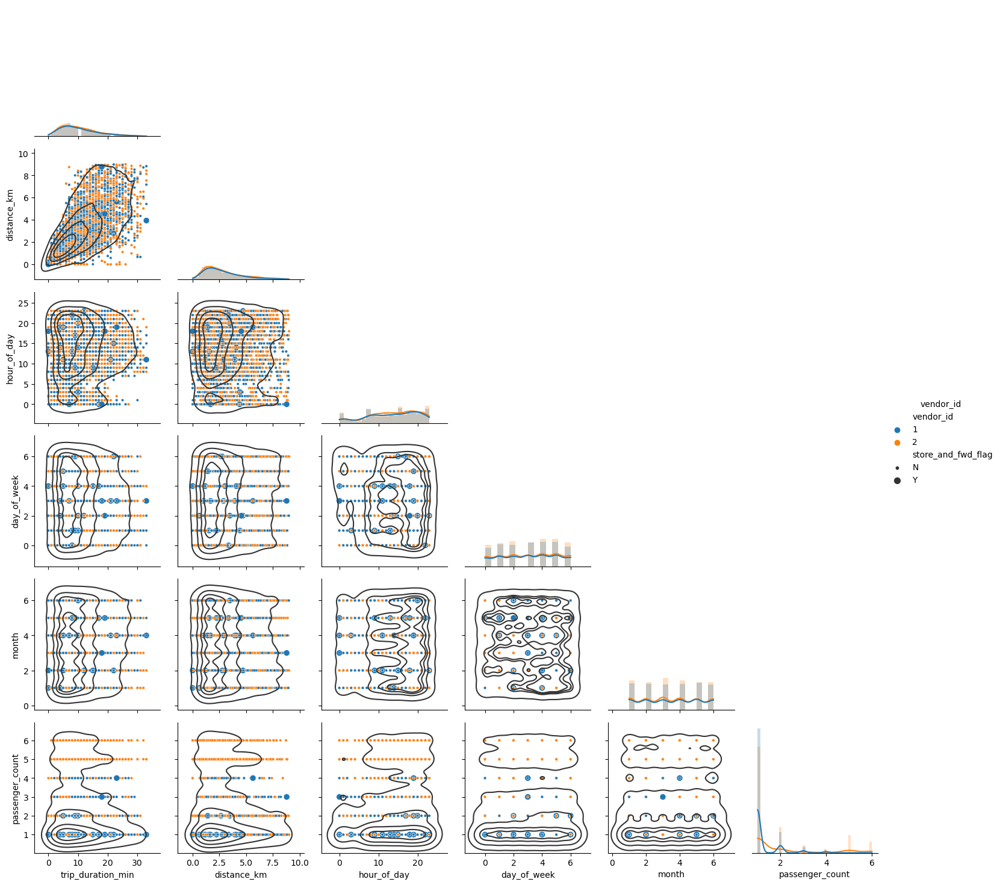

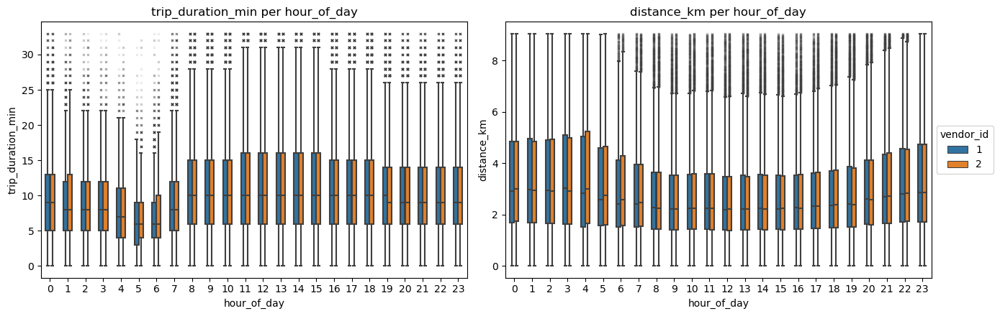

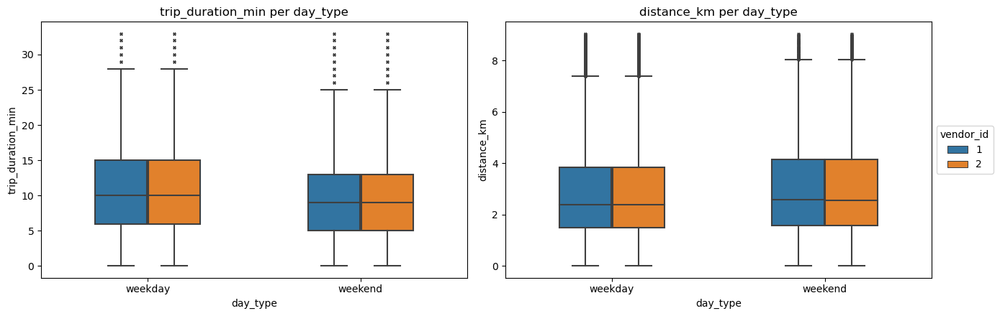

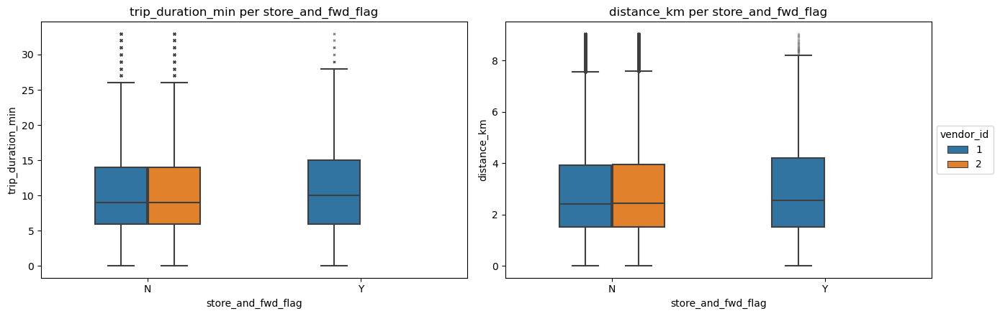

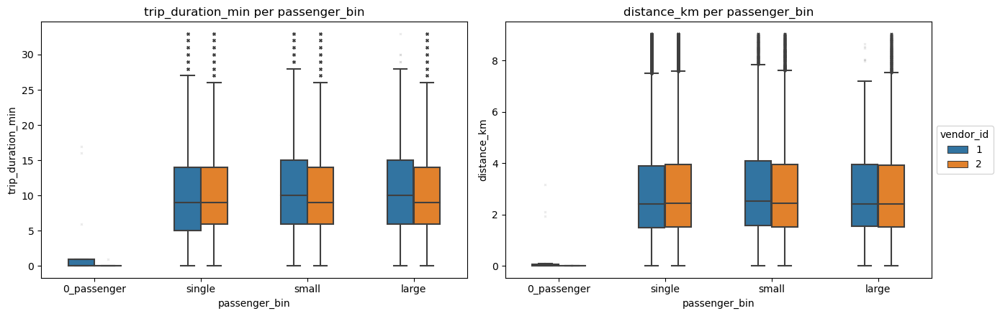

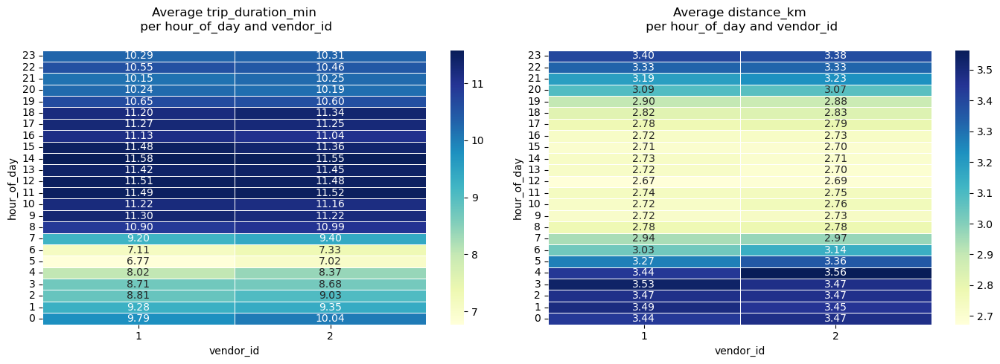

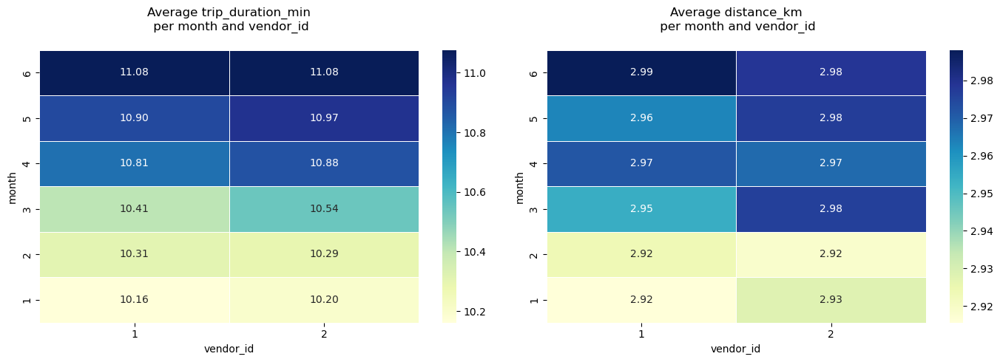

In [ ]:
plot_pairgrid(df,
              columns=['trip_duration_min', 'distance_km', 'hour_of_day', 'day_of_week', 'month', 'passenger_count', 'vendor_id','store_and_fwd_flag'],
              hue='vendor_id', style_col='store_and_fwd_flag',
              sample_size=5000,
              outlier_cols=['trip_duration_min', 'distance_km'])
vertical_plot_box(df, 'hour_of_day', 'trip_duration_min','distance_km', 'vendor_id', remove_outliers_flag=True)
vertical_plot_box(df, 'day_type', 'trip_duration_min','distance_km', 'vendor_id', remove_outliers_flag=True)
vertical_plot_box(df, 'store_and_fwd_flag', 'trip_duration_min','distance_km', 'vendor_id', remove_outliers_flag=True)
vertical_plot_box(df, 'passenger_bin', 'trip_duration_min','distance_km', 'vendor_id', remove_outliers_flag=True)
plot_heatmaps(df, 'trip_duration_min', 'distance_km', 'hour_of_day', 'vendor_id', remove_outliers_flag=True)
plot_heatmaps(df, 'trip_duration_min', 'distance_km', 'month', 'vendor_id', remove_outliers_flag=True)


### 4.3 Passenger Correlation

#### Summary:
- Excluding outliers (trips with no passengers and those with more than 6 passengers), trips with 1-6 passengers exhibit a similar pattern in terms of average trip duration and distance.
- No discernible relationship is observed between passenger group size and variables such as trip distance, duration, and temporal aspects.

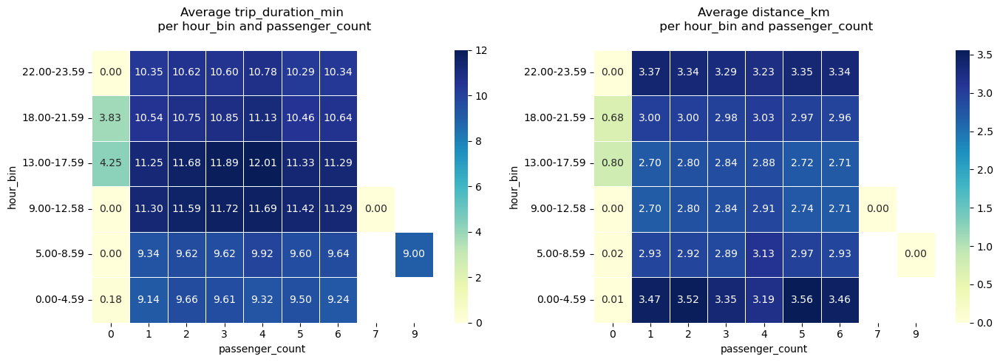

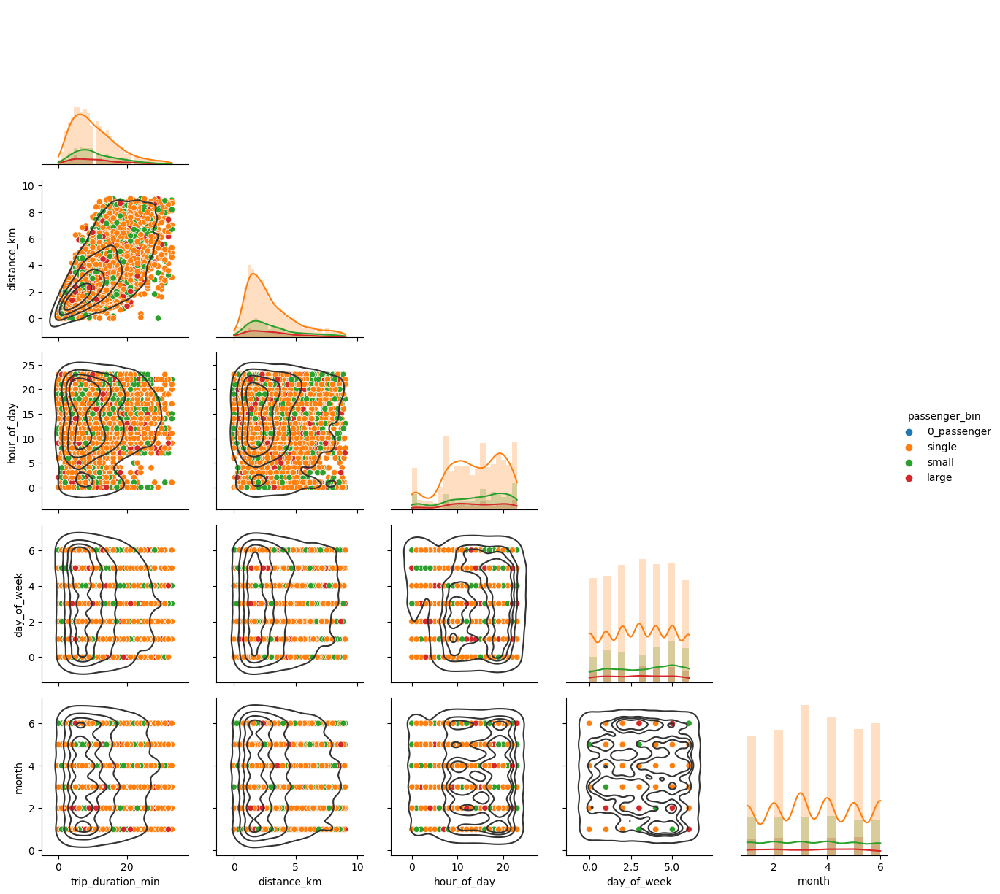

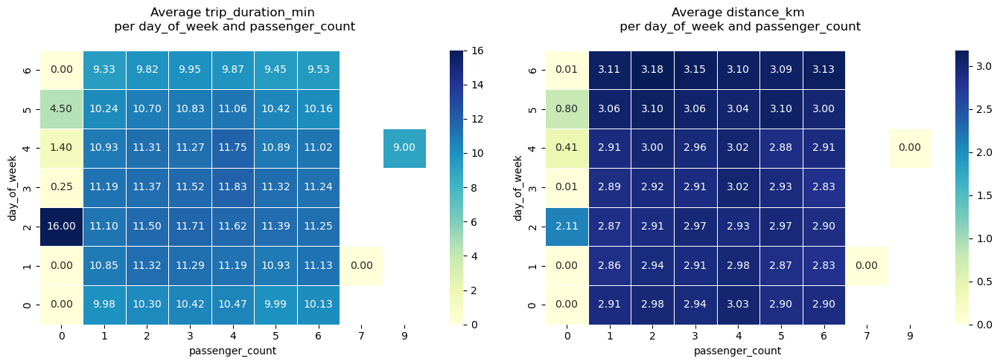

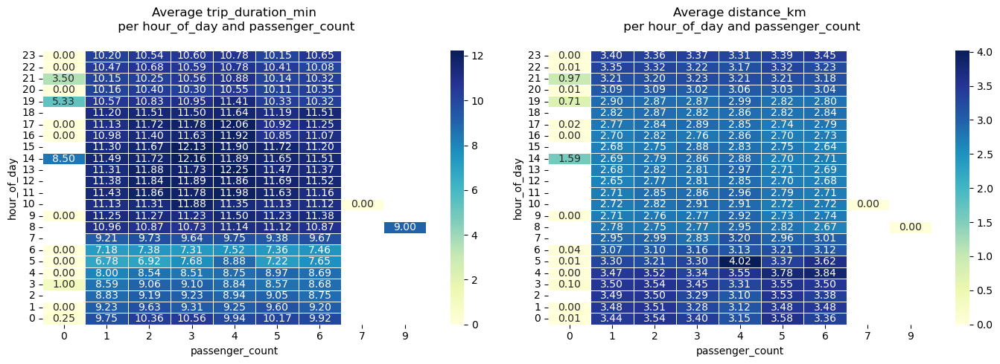

In [ ]:
plot_heatmaps(df, 'trip_duration_min', 'distance_km', 'hour_bin', 'passenger_count', remove_outliers_flag=True)

plot_pairgrid(df,
              columns=['trip_duration_min', 'distance_km', 'hour_of_day', 'day_of_week', 'month', 'passenger_bin', 'vendor_id','store_and_fwd_flag'],
              hue='passenger_bin',
              sample_size=5000,
              outlier_cols=['trip_duration_min', 'distance_km'])
plot_heatmaps(df, 'trip_duration_min', 'distance_km', 'day_of_week', 'passenger_count', remove_outliers_flag=True)
plot_heatmaps(df, 'trip_duration_min', 'distance_km', 'hour_of_day', 'passenger_count', remove_outliers_flag=True)


### 4.4 Spatial Analysis

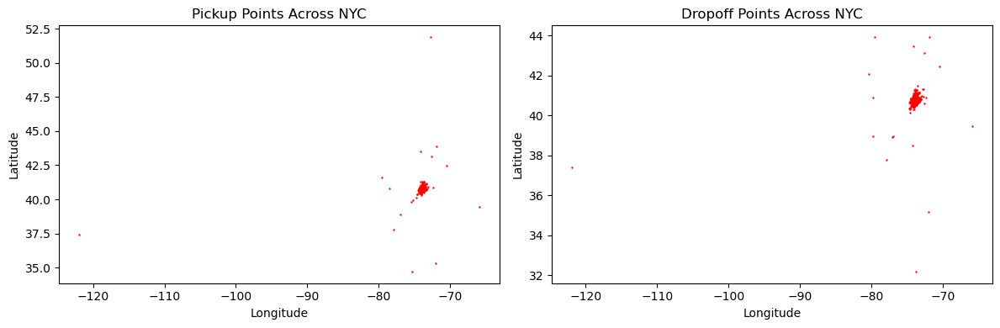

In [ ]:
def plot_location(pickup_data, drop_data):
    plt.figure(figsize=(12, 4))

    # Extract longitude and latitude from geometry
    pickup_x = pickup_data.geometry.x
    pickup_y = pickup_data.geometry.y

    drop_x = drop_data.geometry.x
    drop_y = drop_data.geometry.y

    # Pickup points plot
    plt.subplot(1, 2, 1)
    plt.scatter(pickup_x, pickup_y, color='red', s=0.5)
    plt.title('Pickup Points Across NYC')
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')

    # Dropoff points plot
    plt.subplot(1, 2, 2)
    plt.scatter(drop_x, drop_y, color='red', s=0.5)
    plt.title('Dropoff Points Across NYC')
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')

    plt.tight_layout()
    plt.show()

#gdf_pickup = gpd.GeoDataFrame(geometry=df['geometry_pickup'], crs="EPSG:4326")
#gdf_dropoff = gpd.GeoDataFrame(geometry=df['geometry_dropoff'], crs="EPSG:4326")
plot_location(gdf_pickup, gdf_dropoff)
# we can identify one outlier location

In [ ]:
def plot_folium_map(geo_data, geometry_point, num_points=5000):
    """
    Plots a folium map.
    """
    # New York City bounding box (example coordinates)
    minx, miny, maxx, maxy = [-74.2591, 40.4774, -73.7004, 40.9176]
    # Filtering data within the bounding box
    geo_data = geo_data.set_geometry(geometry_point)
    geo_data_filtered = geo_data.cx[minx:maxx, miny:maxy]

    point_x = geo_data_filtered.geometry.x
    point_y = geo_data_filtered.geometry.y

    # Creating a base map
    m = folium.Map(location=[point_y.mean(), point_x.mean()],
                   tiles='CartoDB Positron',  # Set initial tiles
                   zoom_start=12)
    sample_data = geo_data_filtered.sample(num_points)

    # Adding points to the map
    for _, row in sample_data.iterrows():
        folium.CircleMarker(
            location=[row[geometry_point].y, row[geometry_point].x],
            radius=3,
            color="red",
            fill=True,
            fill_opacity=0.6
        ).add_to(m)

    return m

plot_folium_map(df, geometry_point='geometry_pickup')

In [ ]:
from folium.plugins import HeatMapWithTime
import pandas as pd

def plot_heatmap_with_time(geo_data, geometry_point, time_column, num_points=5000, num_repeats=3, sort_func=None):
    """
    Plots a heatmap with time.
    """
    # New York City bounding box (example coordinates)
    minx, miny, maxx, maxy = [-74.2591, 40.4774, -73.7004, 40.9176]

    # Filtering data within the bounding box
    geo_data = geo_data.set_geometry(geometry_point)
    geo_data_filtered = geo_data.cx[minx:maxx, miny:maxy]

    # Creating a base map
    m = folium.Map(location=[geo_data_filtered.geometry.y.mean(), geo_data_filtered.geometry.x.mean()],
                   zoom_start=11,
                   height='100%')

    # Extract unique time points to iterate over
    unique_time_points = geo_data[time_column].unique()
    if sort_func is not None:
        unique_time_points = sorted(unique_time_points, key=sort_func)
    else:
        unique_time_points = sorted(unique_time_points)

    # Creating a list to hold item represent one frame in the animation
    heatmap_time_data = []
    for time_point in unique_time_points :
        # Extracting data for the specific time point
        subset = geo_data_filtered[geo_data_filtered[time_column] == time_point]
        subset_sample = subset.sample(min(num_points, len(subset)))

        # Extracting lat-long pairs
        frame_data = [[row[geometry_point].y, row[geometry_point].x] for index, row in subset_sample.iterrows()]
        heatmap_time_data.append(frame_data)

    # Repeat the heatmap data to have a longer playback
    heatmap_time_data = heatmap_time_data * num_repeats
    index_labels = [str(i) for i in unique_time_points] * num_repeats

    # Adding HeatMapWithTime layer to the map
    HeatMapWithTime(
        heatmap_time_data,
        auto_play=True,  # Set to False to pause the animation
        max_opacity=0.8,  # Adjust the opacity,
        speed_step=1.25,
        index=index_labels  # Adding labels for time points
    ).add_to(m)
    return m


from IPython.display import HTML
def display_maps(map1, map2, map3, map4, height=1000): #
    """
    Displays two maps side by side.
    """
    map1_html = folium.Map._repr_html_(map1)
    map2_html = folium.Map._repr_html_(map2)
    map3_html = folium.Map._repr_html_(map3)
    map4_html = folium.Map._repr_html_(map4)

    maps_html = f"""
        <div style="display:flex; flex-direction:column; width:100%; height:100vh;">
        <div style="display:flex; width:100%; height:45%;">
            <div style="width:50%; height:100%;">{map1_html}</div>
            <div style="width:50%; height:100%;">{map2_html}</div>
        </div>
        <div style="display:flex; width:100%; height:45%;">
            <div style="width:50%; height:100%;">{map3_html}</div>
            <div style="width:50%; height:100%;">{map4_html}</div>
        </div>
    </div>
    """
    return HTML(maps_html)


def add_title_to_map(m, title_text, font_size=15, color='black'):
    """
    Adds a title to the map.
    """
    title_html = '''
                 <div style="
                             position: fixed;
                             bottom: 45px;
                             left: 0px;
                             width: auto;
                             height: auto;
                             z-index:9999;
                             font-size:{}px;
                             color: {};
                             "><b>{}</b></div>
                 '''.format(font_size, color, title_text)

    return m.get_root().html.add_child(folium.Element(title_html))


def custom_sort(bin):
    # Extract the start of the time bin, convert it to float, and return
    return float(bin.split('-')[0])

In [ ]:
# Display maps side by side
map1 = plot_heatmap_with_time(df[df['day_type']=='weekday'], geometry_point='geometry_pickup', time_column='hour_bin', sort_func=custom_sort)
map2 = plot_heatmap_with_time(df[df['day_type']=='weekday'], geometry_point='geometry_dropoff', time_column='hour_bin', sort_func=custom_sort)
map3 = plot_heatmap_with_time(df[df['day_type']=='weekend'], geometry_point='geometry_pickup', time_column='hour_bin', sort_func=custom_sort)
map4 = plot_heatmap_with_time(df[df['day_type']=='weekend'], geometry_point='geometry_dropoff', time_column='hour_bin', sort_func=custom_sort)
# Add titles
add_title_to_map(map1, 'Pickup Points Heatmap on Weekday', 20, 'black')
add_title_to_map(map2, 'Destination Points Heatmap on Weekday', 20, 'black')
add_title_to_map(map3, 'Pickup Points Heatmap on Weekend', 20, 'black')
add_title_to_map(map4, 'Destination Points Heatmap on Weekend', 20, 'black')
display_maps(map1, map2, map3, map4)


## Summary of Observations on Pickup and Destination Patterns Across Various Time Bins:
### - Early Morning Observations (0-5 AM)
    - Pickup points remain somewhat static, while destinations disperse more broadly, especially on weekdays.
    - Pickup Points:
        - Predominant clusters in whole Manhattan, North Brooklyn, East Queen, and around JFK airport, with sparse activity in the Bronx and New Jersey.
    - Destination Points:
        - Expand to cover these areas wider, including Brooklyn, Queens, and New Jersey coast, with reduced density along the New Jersey coast on weekends.

### - Morning to Noon Shift (5-8 AM to 12 PM):
    - A clear shift is observed in both pickup and destination patterns, moving from a dispersed to a more centralized pattern, indicating the commencement of regular commuting hours and a centralization of activity in Manhattan.
    - Pickup Points:
        - Start decentralizing, focusing toward Manhattan.
        - Begin to densify along the west coast starting 1 PM.
    - Destination Points:
        - Tend to centralize and form three clusters like the pickup points.
        - The clusters become denser and more widespread on weekends from 5 AM, stabilizing by 9 AM.

### - Afternoon to Evening:
    - The persistence and gradual densification of the three clusters for pickup points, alongside the conjoining and scattering of destination points, imply evening commuting patterns and possible leisure or non-work-related activities.
    - Pickup Points:
        - Form three distinct clusters (Manhattan, North Brooklyn, East Queen) that persist from 6 PM onward.
    - Destination Points:
        - Gradually coalesce into a large cluster around 1 PM, starting to scatter and covering additional areas from 6 PM onward.

### Conclusion:
    - A shift in mobility patterns is observed as the day progresses, with distinct clustering and scattering phenomena across different time bins, potentially reflective of varied travel behaviors within the analyzed regions. This preliminary analysis might be enhanced by further exploring the identified clusters and extracting additional insights into mobility, demographic, and socio-economic factors within these zones.
    
--------------------------------------------------------------------------------------

# Consolidated Summary: Data Analysis

## 1. Trip ID
- Solely represents unique identifiers for trips; provides no analytical utility and can be excluded from modeling.

## 2. Passenger Count
- Data reveals potential inaccuracies with zero-passenger instances and occasional high counts.
- Trips without passengers and those with 7-9 passengers are anomalies in the dataset.
- Passenger Correlation
    - Trips with 1-6 passengers generally follow similar patterns in trip duration and distance when outliers are excluded.
    - There is no distinct relationship between the number of passengers and trip characteristics such as distance, duration, or time.


## 3. Distance & Trip Duration
- Possesses critical outliers that can significantly skew analysis and model training
- Strong correlation observed between these variables, which is anticipated but necessitates close examination.
- Distance Type & Passenger Bin
    - Provides a lens into anomalies and patterns, especially zero-distance and zero-passenger trips, highlighting potential data inaccuracies or vendor-specific operational patterns.

## 4. Temporal Variables & Travel Patterns
- While statistical significance is detected, the practical impact on vendor choice and travel patterns across various time frames is understated.
- Various nuances were observed in temporal patterns regarding mean trip durations and distances, hinting at different traveler intents and traffic conditions during weekdays and weekends, and between peak and off-peak hours.
- Trip durations are generally longer on weekdays, while distances traveled tend to be more on weekends.
- Detailed Temporal Patterns Analysis:
   -  Weekday:
       - Early hours see higher distances covered, possibly due to lesser congestion or late-night shifts on weekdays
       - Shorter distances from 8 AM to Midday on weekdays suggest a pattern of midday errands or short business travels during conventional working hours.
       - Trip durations increase during pre-work, post-lunch, and after-work hours, possibly due to congestion.
   - Weekends: have distinct patterns, with shorter durations in the morning and a gradual increase throughout the day.
   - Monthly patterns didn’t exhibit notable disparities.
   
## 5. Vendor-Specific Exploration
- Data showcases a discernible bias towards Vendor 2.
- For  vendor-specific operations, larger passenger groups are mainly served by vender 2, while Vendor 1 primarily handles single-passenger trips.
- Vendor 1 is linked to trips with no passengers and might be engaging in a distinct operational activity (like storing trips before dispatching).

## 6. Store & Forward Flag Analysis
- Rare instances suggest data storage before dispatching to vendors, hinting at potential connectivity or technical issues.
- Notably, these instances correlate with 0-passenger trips, majorly observed with Vendor 1, especially those without passengers.

